In [2]:
using LinearAlgebra
using DiffEqBase
using OrdinaryDiffEq: SplitODEProblem, solve, IMEXEuler, KenCarp4, Tsit5, Rosenbrock23, SBDF2
import SciMLBase
using Plots
using Statistics


In [1029]:
# ρ_yolk = T -> 1037.3 - 0.1386 * (T+270) - 0.0023*(T+270)^2   # kg/m^3
# ρ_albumen = T -> 1043.3 - 0.0115 * (T+270) - 0.0041*(T+270)^2  # kg/m^3
# c_p_yolk = 3120  # kJ/(kg·°C)
# c_p_albumen = 3800  # kJ/(kg·°C)
# k_yolk = T -> 0.0008*(T+270) + 0.395 #0.5  # W/(m·°C)
# k_albumen = T -> 0.0013*(T+270) + 0.5125 #0.6  # W/(m·°C)


# # renormalize for egg lengthscales
# # 62mm	43mm
# egg_diameter = 50e-3 # 43mm

# α_yolk = T -> k_yolk(T) / (ρ_yolk(T) * c_p_yolk * egg_diameter^2) # m^2/s
# α_albumen = T -> k_albumen(T) / (ρ_albumen(T) * c_p_albumen * egg_diameter^2) # m^2/s

# # α_yolk /= egg_diameter^2 # mm/s
# # α_albumen /= egg_diameter^2 # mm/s

# α_yolk(20), α_albumen(20)

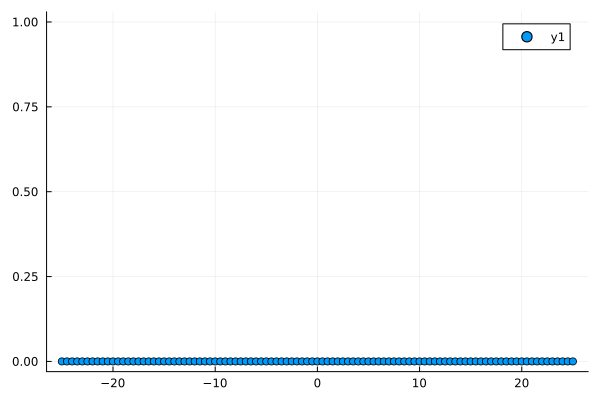

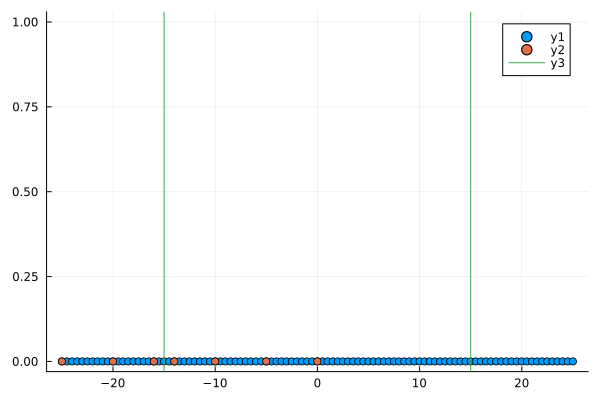

In [3]:
scatter(-25:0.5:25, zeros(100)) |> display

pos_test = [
            1,
            1 + Integer(round(100 / 2 * 0.2)),
            1 + Integer(round(100 / 2 * 0.36)),
            1 + Integer(round(100 / 2 * 0.44)),

            1 + Integer(round(100 / 2 * 0.6)),
            1 + Integer(round(100 / 2 * 0.8)),
            1 + Integer(floor(100/2)) + 0
        ]

scatter!(collect(-25:0.5:25)[pos_test], zeros(7))

vline!([-1.5/2.5 * 25, 1.5/2.5 * 25])

In [36]:
function run_simulation(t_total, pulsing_period, duty_cycle; T_hot, T_cold, Δt, Tegg_init=20, n_cells=50, 
    scaler=0.37, # TODO: why???
    scaler_asym = 1 # TODO: why???
    )

    ρ_yolk = T -> 1037.3 - 0.1386 * (T) - 0.0023*(T)^2   # kg/m^3
    ρ_albumen = T -> 1043.3 - 0.0115 * (T) - 0.0041*(T)^2  # kg/m^3
    c_p_yolk = 3120  # J/(kg·°C)
    c_p_albumen = 3800  # J/(kg·°C)
    k_yolk = T -> 0.0008*(T) + 0.395 #0.5  # W/(m·°C)
    k_albumen = T -> 0.0013*(T) + 0.5125 #0.6  # W/(m·°C)

    # renormalize for egg lengthscales
    # 62mm	43mm
    egg_diameter = scaler*5e-2 #0.5*0.55*43e-3 # 43mm
    yolk_diameter = scaler*2*1.5e-2 # radius 1.5cm # TODO: better agrement when 2 dropped???

    α_yolk = T -> k_yolk(T) / (ρ_yolk(T) * c_p_yolk * (scaler_asym*egg_diameter)^2) # m^2/s
    α_albumen = T -> k_albumen(T) / (ρ_albumen(T) * c_p_albumen * egg_diameter^2) # m^2/s

    function dynamic_alpha_vec(Tvec; n, n_yolk)

        T = clamp.(Tvec, 0, 200)

        α_vec = α_albumen.(T) #[α_albumen(T) for t in T]
        ishift_test = 1
        i1, i2 = ishift_test + 1 + div(n - 1, 2) - div(n_yolk, 2), ishift_test + 1 + div(n - 1, 2) + div(n_yolk, 2)
        α_vec[i1:i2] .= α_yolk.(T[i1:i2])
        α_vec
    end

    FT = Float64; # float type

    a, b, n = 0, 1, n_cells   # zmin, zmax
    n_yolk = Integer(round(yolk_diameter*n_cells/egg_diameter)) #11
    # n̂_min, n̂_max = -1, 1  # Outward facing unit vectors
    β, γ = 0, π;  # source term coefficients
    N_t = Integer(ceil(t_total / Δt));  # number of timesteps to take
    
    Δz = FT(b - a) / FT(n)
    Δz² = Δz^2;
    ∇²_op = [1 / Δz², -2 / Δz², 1 / Δz²];  # interior Laplacian operator

    S(z) = β * sin(γ * z)               # source term, (sin for easy integration)
    zf = range(a, b, length = n + 1);   # coordinates on cell faces

    # pulsing_period = 2*60;

    # α_vec = [α_albumen(80) for i in 1:n+1]
    # α_vec[1 + div(n - 1, 2) - div(n_yolk, 2):1 + div(n - 1, 2) + div(n_yolk, 2)] .= α_yolk(80)

    α_vec = dynamic_alpha_vec(ones(n+1)*80; n=n, n_yolk=n_yolk)

    # plot(α_vec, marker="o")

    # Initialize interior and boundary stencils:
    ∇² = Tridiagonal(ones(FT, n) .* ∇²_op[1],
    ones(FT, n + 1) .* ∇²_op[2],
    ones(FT, n) .* ∇²_op[3]);

    # Modify boundary stencil to account for BCs

    ∇².du[1] = 0  # modified stencil
    ∇².d[1] = 0 # to ensure `∂_t T = 0` at `z=0`
    ∇².dl[1] = 0  # to ensure `∂_t T = 0` at `z=0`

    ∇².du[n] = 0  # modified stencil
    ∇².d[n + 1] = 0 # to ensure `∂_t T = 0` at `z=zmax`
    ∇².dl[n] = 0  # to ensure `∂_t T = 0` at `z=zmax`

    # Calculate 
    D = α_vec .* ∇²

    T0 = zeros(FT, n + 1);
    T0 .= Tegg_init; 
    T0[1] = T_hot; # set top BC
    T0[n + 1] = T_hot; # set top BC

    function temp_from_thermal_state(thermal_state)
        if thermal_state == 0
            return T_hot
        else
            return T_cold
        end
    end
    
    function condition(u, t, integrator)
        # mod(t, pulsing_period) == 0
        cycle_position = mod(t, pulsing_period)
        cycle_on_time = pulsing_period * duty_cycle
        
        (cycle_position == cycle_on_time) || (cycle_position == 0)
    end
    
    function affect!(integrator)
        n = integrator.p[1]
        n_yolk = integrator.p[2]
        thermal_state = mod(integrator.p[3] + 1, 2)
        integrator.p = (; n=n, n_yolk=n_yolk, thermal_state=thermal_state)
    
        T = temp_from_thermal_state(thermal_state)
    
        integrator.u[1] = T
        integrator.u[2] = T
        integrator.u[n] = T
        integrator.u[n+1] = T
    end

    @assert duty_cycle >= 0 && duty_cycle < 0.99
    
    if duty_cycle >= 0.01
        cb = DiscreteCallback(condition, affect!)
        opts = Dict(:callback => cb, :tstops => (0:pulsing_period * duty_cycle:N_t * FT(Δt)))
    else
        opts = Dict(:callback => nothing)
    end

    function rhs!(dT, T, params, t)
        n = params.n
        i = 1:n # interior domain
        
        source_temp = temp_from_thermal_state(params.thermal_state);
        AT_b = source_temp / Δz²;
        
        dT .= 0
        dT[2] = α_albumen(T[2]) * AT_b 
        dT[n] = α_albumen(T[n]) * AT_b

        dT
    end

    params = (; n, n_yolk, thermal_state=0.)

    tspan = (FT(0), N_t * FT(Δt))

    function update_func!(A, u, p, t)
        # @show u[20]
        A .= dynamic_alpha_vec(u; n_yolk=p.n_yolk, n=p.n) .* ∇²
        A
    end

    prob = SplitODEProblem(SciMLBase.DiffEqArrayOperator(D; update_func=update_func!),
        rhs!,
        T0,
        tspan,
        params)
    alg = SBDF2(autodiff=false); #IMEXEuler(autodiff=false);
    # println("Solving...")
    sol = solve(prob,
        alg;
        dt = Δt,
        saveat = range(FT(0), N_t * FT(Δt), length = N_t),
        # callback = cb,
        progress = true,
        progress_message = (dt, u, p, t) -> t,
        opts...
        # tstops = (duty_cycle != 0) ? (0:pulsing_period * duty_cycle:N_t * FT(Δt)) : nothing,
    )

end

run_simulation (generic function with 1 method)

In [37]:
function run_simulation_sin(t_total, sin_period, amplitude; T_hot, Δt, Tegg_init=20, n_cells=50, 
    scaler=0.37, # TODO: why???
    scaler_asym = 1 # TODO: why???
    )

    ρ_yolk = T -> 1037.3 - 0.1386 * (T) - 0.0023*(T)^2   # kg/m^3
    ρ_albumen = T -> 1043.3 - 0.0115 * (T) - 0.0041*(T)^2  # kg/m^3
    c_p_yolk = 3120  # J/(kg·°C)
    c_p_albumen = 3800  # J/(kg·°C)
    k_yolk = T -> 0.0008*(T) + 0.395 #0.5  # W/(m·°C)
    k_albumen = T -> 0.0013*(T) + 0.5125 #0.6  # W/(m·°C)

    # renormalize for egg lengthscales
    # 62mm	43mm
    egg_diameter = scaler*5e-2 #0.5*0.55*43e-3 # 43mm
    yolk_diameter = scaler*2*1.5e-2 # radius 1.5cm # TODO: better agrement when 2 dropped???

    α_yolk = T -> k_yolk(T) / (ρ_yolk(T) * c_p_yolk * (scaler_asym*egg_diameter)^2) # m^2/s
    α_albumen = T -> k_albumen(T) / (ρ_albumen(T) * c_p_albumen * egg_diameter^2) # m^2/s

    function dynamic_alpha_vec(Tvec; n, n_yolk)

        T = clamp.(Tvec, 0, 200)

        α_vec = α_albumen.(T) #[α_albumen(T) for t in T]
        ishift_test = 1
        i1, i2 = ishift_test + 1 + div(n - 1, 2) - div(n_yolk, 2), ishift_test + 1 + div(n - 1, 2) + div(n_yolk, 2)
        α_vec[i1:i2] .= α_yolk.(T[i1:i2])
        α_vec
    end

    FT = Float64; # float type

    a, b, n = 0, 1, n_cells   # zmin, zmax
    n_yolk = Integer(round(yolk_diameter*n_cells/egg_diameter)) #11
    # n̂_min, n̂_max = -1, 1  # Outward facing unit vectors
    β, γ = 0, π;  # source term coefficients
    N_t = Integer(ceil(t_total / Δt));  # number of timesteps to take
    
    Δz = FT(b - a) / FT(n)
    Δz² = Δz^2;
    ∇²_op = [1 / Δz², -2 / Δz², 1 / Δz²];  # interior Laplacian operator

    S(z) = β * sin(γ * z)               # source term, (sin for easy integration)
    zf = range(a, b, length = n + 1);   # coordinates on cell faces

    # pulsing_period = 2*60;

    # α_vec = [α_albumen(80) for i in 1:n+1]
    # α_vec[1 + div(n - 1, 2) - div(n_yolk, 2):1 + div(n - 1, 2) + div(n_yolk, 2)] .= α_yolk(80)

    α_vec = dynamic_alpha_vec(ones(n+1)*80; n=n, n_yolk=n_yolk)

    # plot(α_vec, marker="o")

    # Initialize interior and boundary stencils:
    ∇² = Tridiagonal(ones(FT, n) .* ∇²_op[1],
    ones(FT, n + 1) .* ∇²_op[2],
    ones(FT, n) .* ∇²_op[3]);

    # Modify boundary stencil to account for BCs

    ∇².du[1] = 0  # modified stencil
    ∇².d[1] = 0 # to ensure `∂_t T = 0` at `z=0`
    ∇².dl[1] = 0  # to ensure `∂_t T = 0` at `z=0`

    ∇².du[n] = 0  # modified stencil
    ∇².d[n + 1] = 0 # to ensure `∂_t T = 0` at `z=zmax`
    ∇².dl[n] = 0  # to ensure `∂_t T = 0` at `z=zmax`

    # Calculate 
    D = α_vec .* ∇²

    T0 = zeros(FT, n + 1);
    T0 .= Tegg_init; 
    T0[1] = T_hot; # set top BC
    T0[n + 1] = T_hot; # set top BC

    # function temp_from_thermal_state(thermal_state)
    #     if thermal_state == 0
    #         return T_hot
    #     else
    #         return T_cold
    #     end
    # end
    
    # function condition(u, t, integrator)
    #     # mod(t, pulsing_period) == 0
    #     cycle_position = mod(t, pulsing_period)
    #     cycle_on_time = pulsing_period * duty_cycle
        
    #     (cycle_position == cycle_on_time) || (cycle_position == 0)
    # end
    
    # function affect!(integrator)
    #     n = integrator.p[1]
    #     n_yolk = integrator.p[2]
    #     thermal_state = mod(integrator.p[3] + 1, 2)
    #     integrator.p = (; n=n, n_yolk=n_yolk, thermal_state=thermal_state)
    
    #     T = temp_from_thermal_state(thermal_state)
    
    #     integrator.u[1] = T
    #     integrator.u[2] = T
    #     integrator.u[n] = T
    #     integrator.u[n+1] = T
    # end

    # @assert duty_cycle >= 0 && duty_cycle < 0.99
    
    # if duty_cycle >= 0.01
    #     cb = DiscreteCallback(condition, affect!)
    #     opts = Dict(:callback => cb, :tstops => (0:pulsing_period * duty_cycle:N_t * FT(Δt)))
    # else
    #     opts = Dict(:callback => nothing)
    # end

    function rhs!(dT, T, params, t)
        n = params.n
        i = 1:n # interior domain
        
        # source_temp = temp_from_thermal_state(params.thermal_state);

        source_temp = T_hot + amplitude * sin(2 * π * t / sin_period)
        AT_b = source_temp / Δz²;
        
        dT .= 0
        dT[2] = α_albumen(T[2]) * AT_b 
        dT[n] = α_albumen(T[n]) * AT_b

        dT
    end

    params = (; n, n_yolk, thermal_state=0.)

    tspan = (FT(0), N_t * FT(Δt))

    function update_func!(A, u, p, t)
        # @show u[20]
        A .= dynamic_alpha_vec(u; n_yolk=p.n_yolk, n=p.n) .* ∇²
        A
    end

    prob = SplitODEProblem(SciMLBase.DiffEqArrayOperator(D; update_func=update_func!),
        rhs!,
        T0,
        tspan,
        params)
    alg = SBDF2(autodiff=false); #IMEXEuler(autodiff=false);
    # println("Solving...")
    sol = solve(prob,
        alg;
        dt = Δt,
        saveat = range(FT(0), N_t * FT(Δt), length = N_t),
        # callback = cb,
        progress = true,
        progress_message = (dt, u, p, t) -> t,
        # opts...
        # tstops = (duty_cycle != 0) ? (0:pulsing_period * duty_cycle:N_t * FT(Δt)) : nothing,
    )

end

run_simulation_sin (generic function with 1 method)

In [38]:
function run_simulation_steps(t_total, pulsing_period, pulse_sequence; Δt, Tegg_init=20, n_cells=50, 
    scaler=0.37, # TODO: why???
    scaler_asym = 1 # TODO: why???
    )

    T_init = pulse_sequence[1]
    duty_cycle = 1 # test

    @assert length(pulse_sequence) * pulsing_period >= t_total

    ρ_yolk = T -> 1037.3 - 0.1386 * (T) - 0.0023*(T)^2   # kg/m^3
    ρ_albumen = T -> 1043.3 - 0.0115 * (T) - 0.0041*(T)^2  # kg/m^3
    c_p_yolk = 3120  # J/(kg·°C)
    c_p_albumen = 3800  # J/(kg·°C)
    k_yolk = T -> 0.0008*(T) + 0.395 #0.5  # W/(m·°C)
    k_albumen = T -> 0.0013*(T) + 0.5125 #0.6  # W/(m·°C)

    # renormalize for egg lengthscales
    # 62mm	43mm
    egg_diameter = scaler*5e-2 #0.5*0.55*43e-3 # 43mm
    yolk_diameter = scaler*2*1.5e-2 # radius 1.5cm # TODO: better agrement when 2 dropped???

    α_yolk = T -> k_yolk(T) / (ρ_yolk(T) * c_p_yolk * (scaler_asym*egg_diameter)^2) # m^2/s
    α_albumen = T -> k_albumen(T) / (ρ_albumen(T) * c_p_albumen * egg_diameter^2) # m^2/s

    function dynamic_alpha_vec(Tvec; n, n_yolk)

        T = clamp.(Tvec, 0, 200)

        α_vec = α_albumen.(T) #[α_albumen(T) for t in T]
        ishift_test = 1
        i1, i2 = ishift_test + 1 + div(n - 1, 2) - div(n_yolk, 2), ishift_test + 1 + div(n - 1, 2) + div(n_yolk, 2)
        α_vec[i1:i2] .= α_yolk.(T[i1:i2])
        α_vec
    end

    FT = Float64; # float type

    a, b, n = 0, 1, n_cells   # zmin, zmax
    n_yolk = Integer(round(yolk_diameter*n_cells/egg_diameter)) #11
    # n̂_min, n̂_max = -1, 1  # Outward facing unit vectors
    β, γ = 0, π;  # source term coefficients
    N_t = Integer(ceil(t_total / Δt));  # number of timesteps to take
    
    Δz = FT(b - a) / FT(n)
    Δz² = Δz^2;
    ∇²_op = [1 / Δz², -2 / Δz², 1 / Δz²];  # interior Laplacian operator

    S(z) = β * sin(γ * z)               # source term, (sin for easy integration)
    zf = range(a, b, length = n + 1);   # coordinates on cell faces

    # pulsing_period = 2*60;

    # α_vec = [α_albumen(80) for i in 1:n+1]
    # α_vec[1 + div(n - 1, 2) - div(n_yolk, 2):1 + div(n - 1, 2) + div(n_yolk, 2)] .= α_yolk(80)

    α_vec = dynamic_alpha_vec(ones(n+1)*80; n=n, n_yolk=n_yolk)

    # plot(α_vec, marker="o")

    # Initialize interior and boundary stencils:
    ∇² = Tridiagonal(ones(FT, n) .* ∇²_op[1],
    ones(FT, n + 1) .* ∇²_op[2],
    ones(FT, n) .* ∇²_op[3]);

    # Modify boundary stencil to account for BCs

    ∇².du[1] = 0  # modified stencil
    ∇².d[1] = 0 # to ensure `∂_t T = 0` at `z=0`
    ∇².dl[1] = 0  # to ensure `∂_t T = 0` at `z=0`

    ∇².du[n] = 0  # modified stencil
    ∇².d[n + 1] = 0 # to ensure `∂_t T = 0` at `z=zmax`
    ∇².dl[n] = 0  # to ensure `∂_t T = 0` at `z=zmax`

    # Calculate 
    D = α_vec .* ∇²

    T0 = zeros(FT, n + 1);
    T0 .= Tegg_init; 
    T0[1] = T_init; # set top BC
    T0[n + 1] = T_init; # set top BC

    function temp_from_thermal_state(thermal_state)
        pulse_sequence[clamp(Integer(thermal_state)+1, 1, length(pulse_sequence))]
    end
    
    function condition(u, t, integrator)
        # mod(t, pulsing_period) == 0
        cycle_position = mod(t, pulsing_period)
        cycle_on_time = pulsing_period * duty_cycle
        
        (cycle_position == cycle_on_time) || (cycle_position == 0)
    end
    
    function affect!(integrator)
        n = integrator.p[1]
        n_yolk = integrator.p[2]
        thermal_state = integrator.p[3] + 1
        integrator.p = (; n=n, n_yolk=n_yolk, thermal_state=thermal_state)
    
        T = temp_from_thermal_state(thermal_state)
    
        integrator.u[1] = T
        integrator.u[2] = T
        integrator.u[n] = T
        integrator.u[n+1] = T
    end
    
    cb = DiscreteCallback(condition, affect!)
    opts = Dict(:callback => cb, :tstops => (0:pulsing_period * duty_cycle:N_t * FT(Δt)))

    function rhs!(dT, T, params, t)
        n = params.n
        i = 1:n # interior domain
        
        source_temp = temp_from_thermal_state(params.thermal_state);
        AT_b = source_temp / Δz²;
        
        dT .= 0
        dT[2] = α_albumen(T[2]) * AT_b 
        dT[n] = α_albumen(T[n]) * AT_b

        dT
    end

    params = (; n, n_yolk, thermal_state=0.)

    tspan = (FT(0), N_t * FT(Δt))

    function update_func!(A, u, p, t)
        # @show u[20]
        A .= dynamic_alpha_vec(u; n_yolk=p.n_yolk, n=p.n) .* ∇²
        A
    end

    prob = SplitODEProblem(SciMLBase.DiffEqArrayOperator(D; update_func=update_func!),
        rhs!,
        T0,
        tspan,
        params)
    alg = SBDF2(autodiff=false); #IMEXEuler(autodiff=false);
    # println("Solving...")
    sol = solve(prob,
        alg;
        dt = Δt,
        saveat = range(FT(0), N_t * FT(Δt), length = N_t),
        # callback = cb,
        progress = true,
        progress_message = (dt, u, p, t) -> t,
        opts...
        # tstops = (duty_cycle != 0) ? (0:pulsing_period * duty_cycle:N_t * FT(Δt)) : nothing,
    )

end

run_simulation_steps (generic function with 1 method)

positions = [2, 1 + Integer(round((sol.prob.p.n / 2) * 0.2)), 1 + Integer(round((sol.prob.p.n / 2) * 0.36)), 1 + Integer(round((sol.prob.p.n / 2) * 0.44)), 1 + Integer(round((sol.prob.p.n / 2) * 0.6)), 1 + Integer(round((sol.prob.p.n / 2) * 0.8)), 1 + Integer(floor(sol.prob.p.n / 2)) + 0] = [2, 6, 10, 12, 16, 21, 26]


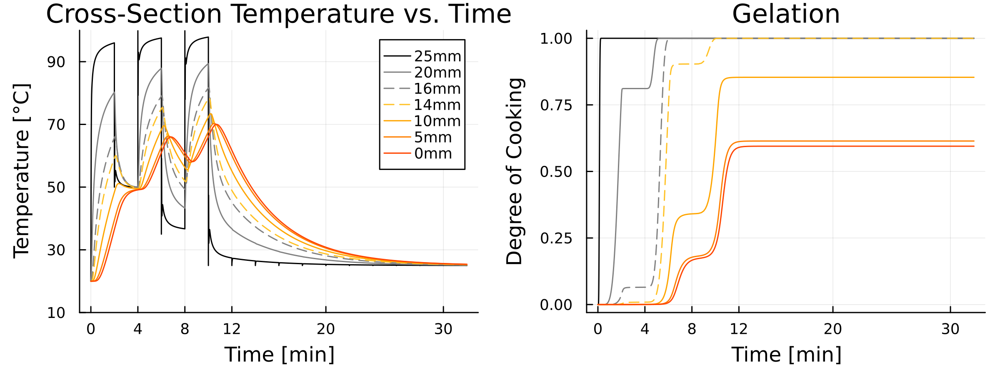

In [43]:
test = run_simulation_steps(32*60, 2*60, vcat([100., 50., 100., 35., 100., 25.], repeat([25.], 10)); Δt=1)
# test = run_simulation_steps(32*60, 2*60, repeat([100., 20.], 16); Δt=1)

test2 = gelation_sim(test);

fig = generate_plots(test, test2)
# plot!(fig[2], sous_vide_sims[:, 1], sous_vide_sims[:, [2,3,4,5,7,8,9]], color="green")


# ylims!(fig[1], 280,  390)
# yticks!(fig[1], 280:20:390)
ylims!(fig[1], 10, 100)
yticks!(fig[1], 10:20:100)
xticks!(vcat(0:4:12, [20, 30]))

# savefig("/Users/torque/web/itstorque.com/_blog_posts/2025_02_17_egg_sims/faster_pulsing_egg.png")


# ylims!(fig[1], 280, 350)
# xticks!(0:10:60)
fig

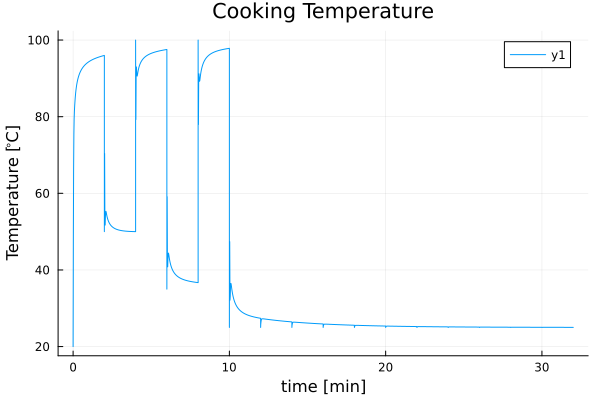

In [50]:
plot(test.t/60, hcat(test.u...)[2, :], title="Cooking Temperature")
xlabel!("time [min]")
ylabel!("Temperature [\$\\degree\$C]")

In [1096]:
hard_boiled_sims[:, [2,3,4,5,7,8,9]]

61×7 Matrix{Float64}:
 5.0e-12   5.0e-12   5.0e-12     5.0e-14     4.27e-13    2.5e-6     0.0
 4.19e-8   4.19e-8   4.19e-8     4.2e-10     2.85e-13    1.76e-5    1.0
 8.37e-8   8.37e-8   8.41e-8     9.49e-10    4.21e-12    1.76e-5    1.0
 1.26e-7   1.26e-7   1.3e-7      2.55e-9     4.21e-11    1.76e-5    1.0
 1.68e-7   1.69e-7   1.95e-7     1.75e-8     3.61e-9     0.0129394  1.0
 2.11e-7   2.16e-7   3.28e-7     1.22e-7     4.15e-8     0.0721507  1.0
 2.56e-7   2.76e-7   7.17e-7     1.17e-6     8.28e-7     0.321026   1.0
 3.08e-7   3.58e-7   1.96e-6     7.46e-6     7.34e-6     0.686609   1.0
 3.75e-7   5.1e-7    8.47e-6     5.6e-5      7.3e-5      0.976645   1.0
 5.1e-7    1.02e-6   5.5e-5      0.00045     0.000654    1.0        1.0
 7.02e-7   1.84e-6   0.000135    0.00113111  0.00166326  1.0        1.0
 1.26e-6   5.52e-6   0.000725    0.00422224  0.00630133  1.0        1.0
 2.57e-6   1.53e-5   0.00241606  0.0123494   0.0185282   1.0        1.0
 ⋮                                        

switch_times_sol = [hard_boiled_sims[i[1], 1] for i = (findmin(abs.(hard_boiled_sims[:, [2, 3, 4, 5, 7, 8, 9]] .- 0.5), dims = 1))[2]] = [5.6 5.0 3.6 3.6 3.4 1.2 1.4]


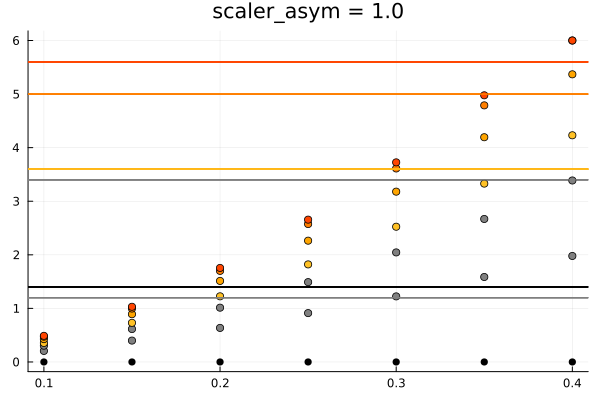

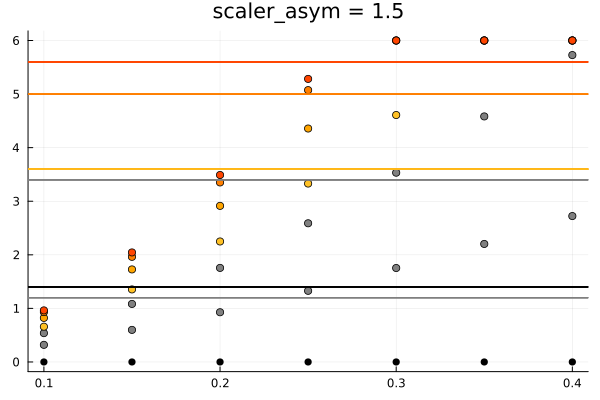

In [ ]:
@show switch_times_sol = [hard_boiled_sims[i[1], 1] for i in findmin(abs.(hard_boiled_sims[:, [2,3,4,5,7,8,9]] .- 0.5), dims=1)[2]]

for i in [1, 1.5]#1:0.5:3
    # j=0.35
    fig = plot(legend=false)

    for j in 0.1:0.05:0.4#3:10#0.3:0.01:0.4
        sol = run_simulation(6*60, 2*60, 0; T_hot=100., T_cold=20., Δt=0.5, scaler=j, scaler_asym=i);
        sol2 = gelation_sim(sol);


        # fig = generate_plots(sol, sol2)
        # plot!(fig[2], hard_boiled_sims[:, 1], hard_boiled_sims[:, [2,3,4,5,7,8,9]], color="green")
        # xlims!(fig[2], xlims(fig[1]))

        # savefig("/Users/torque/web/itstorque.com/_blog_posts/2025_02_17_egg_sims/soft_boiled_egg.png")

        positions = [
            1,
            1 + Integer(round(sol.prob.p.n / 2 * 0.2)),
            1 + Integer(round(sol.prob.p.n / 2 * 0.36)),
            1 + Integer(round(sol.prob.p.n / 2 * 0.44)),

            1 + Integer(round(sol.prob.p.n / 2 * 0.6)),
            1 + Integer(round(sol.prob.p.n / 2 * 0.8)),
            1 + Integer(floor(sol.prob.p.n/2)) + 0
        ]
    
        # plot(hcat(sol2.u...)[positions, :] |> transpose)

        switch_times = [sol2.t[i[2]] / 60 for i in findmin(abs.(hcat(sol2.u...)[positions, :] .- 0.5), dims=2)[2]]

        # switch_times = []

        scatter!(switch_times*0 .+ j, switch_times, color=[
            :black,
            :grey,
            :grey,
            :goldenrod1,
            :orange,
            :darkorange1,
            :orangered
        ])

        for (v, c) in zip(switch_times_sol, [
            :orangered,
            :darkorange1,
            :orange,
            :goldenrod1,
            :grey,
            :grey,
            :black
        ])
            hline!([v], color=c)
        end
        plot!(title="scaler_asym = $i")


    end
    fig |> display
end

In [1068]:
0.2 * 2.5

0.5

In [222]:
function generate_plots(sol, sol2)
    p1 = Plots.plot(; xlabel="Time [min]", 
    ylabel = plot_in_kelvin ? "Temperature [K]" : "Temperature [°C]", 
    title="Cross-Section Temperature vs. Time")

    @show positions = [
        2,
        1 + Integer(round(sol.prob.p.n / 2 * 0.2)),
        1 + Integer(round(sol.prob.p.n / 2 * 0.36)),
        1 + Integer(round(sol.prob.p.n / 2 * 0.44)),

        1 + Integer(round(sol.prob.p.n / 2 * 0.6)),
        1 + Integer(round(sol.prob.p.n / 2 * 0.8)),
        1 + Integer(floor(sol.prob.p.n/2)) + 0
    ]

    labels = [
        "25mm",
        "20mm",
        "16mm",
        "14mm",
        "10mm",
        "5mm",
        "0mm"
    ]

    colors = [
        :black,
        :grey,
        :grey,
        :goldenrod1,
        :orange,
        :darkorange1,
        :orangered
    ]

    styles = [
        :solid,
        :solid,
        :dash,
        :dash,
        :solid,
        :solid,
        :solid
    ]

    for (i, pos) in enumerate(positions)
        Plots.plot!(sol.t/60, temperature_offset .+ hcat(sol.u...)[pos, :], label=labels[i], color=colors[i], style=styles[i])
    end

    #####

    p2 = plot(title="Gelation", xlabel="Time [min]", ylabel="Degree of Cooking", legend = false, ylim=(0, 1))

    for (i, pos) in enumerate(positions)
        plot!(sol2.t/60, hcat(sol2.u...)[pos, :], label=labels[i], color=colors[i], style=styles[i])
    end
    
    plot(p1, p2, layout=(1, 2), size=(800, 300), dpi=300, left_margin = 5Plots.mm, bottom_margin=5Plots.mm)
end

generate_plots (generic function with 1 method)

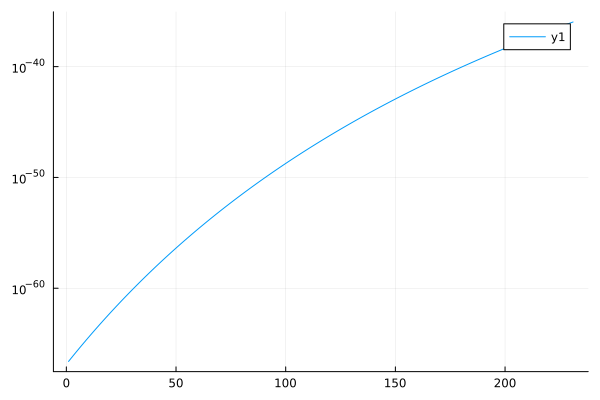

In [136]:
plot(exp.(-3.443e5 ./ (R .* (270:500))), yscale=:log10)

In [33]:
Ai_yolk, Eai_yolk       = 2.72e50, 3.443e5 # s^-1 and J
Ai_albumen, Eai_albumen = 4.85e60, 4.185e5 # s^-1 and J

R = 8.3144598 # J⋅mol^−1⋅K^−1

function gelation_sim(sol)
    n, n_yolk, _ = sol.prob.p

    i1, i2 = 1 + div(n - 1, 2) - div(n_yolk, 2), 1 + div(n - 1, 2) + div(n_yolk, 2)

    Ai_vec = Ai_albumen * ones(n+1)
    Ai_vec[i1:i2] .= Ai_yolk

    Eai_vec = Eai_albumen * ones(n+1)
    Eai_vec[i1:i2] .= Eai_yolk

    function cooking!(du, u, p, t)
        temp = sol(t) .+ 273.15
        du .= Ai_vec .* exp.(-Eai_vec ./ (R .* (temp))) .* (1 .- u)
    end

    u0 = zeros(length(sol.u[1]))
    cooking_prob = ODEProblem(cooking!, u0, (sol.t[1], sol.t[end]))
    sol2 = solve(cooking_prob, Rosenbrock23(autodiff = false), dt=0.1)
    
    sol2
end

gelation_sim (generic function with 1 method)

In [1181]:
hard_boiled_sims = [0	5.00E-12	5.00E-12	5.00E-12	5.00E-14	2.97E-12	4.27E-13	2.50E-06	0
0.2	4.19E-08	4.19E-08	4.19E-08	4.20E-10	2.52E-08	2.85E-13	1.76E-05	1
0.4	8.37E-08	8.37E-08	8.41E-08	9.49E-10	6.87E-08	4.21E-12	1.76E-05	1
0.6	1.26E-07	1.26E-07	1.30E-07	2.55E-09	3.50E-07	4.21E-11	1.76E-05	1
0.8	1.68E-07	1.69E-07	1.95E-07	1.75E-08	5.95E-06	3.61E-09	0.012939374188141	1
1	2.11E-07	2.16E-07	3.28E-07	1.22E-07	5.29E-05	4.15E-08	0.0721507081483942	1
1.2	2.56E-07	2.76E-07	7.17E-07	1.17E-06	5.91E-04	8.28E-07	0.321026286245719	1
1.4	3.08E-07	3.58E-07	1.96E-06	7.46E-06	0.00371901059752406	7.34E-06	0.686608780903623	0.999999516304177
1.6	3.75E-07	5.10E-07	8.47E-06	5.60E-05	0.0196440027641995	7.30E-05	0.976644983224522	1.00000031327029
1.8	5.10E-07	1.02E-06	5.50E-05	4.50E-04	0.116993177269118	6.54E-04	1	1.00000030186775
2	7.02E-07	1.84E-06	1.35E-04	0.00113111254129748	0.282464738733705	0.00166326276269796	1	1.00000032831911
2.2	1.26E-06	5.52E-06	7.25E-04	0.00422223888318431	0.482215821584505	0.00630132600725746	1	1.00000032969294
2.4	2.57E-06	1.53E-05	0.00241605828559336	0.0123494375334026	0.674382426099038	0.0185282331380347	1	1.00000022814239
2.6	4.36E-06	2.89E-05	0.0048120086289672	0.0237531762112656	0.887014623830434	0.035690774866923	1	1.00000007582706
2.8	1.86E-05	1.52E-04	0.0218967348070443	0.0616545270553615	1	0.0869187377391088	0.982143979996273	0.999999992681774
3	4.52E-05	3.82E-04	0.0535814280659547	0.125906016321956	1	0.172027122601652	0.980609521421427	0.999999977944826
3.2	1.02E-04	8.38E-04	0.100509861009988	0.212645708864227	0.99828195728184	0.284772970203706	1	1.00000000106053
3.4	5.99E-04	0.00435023349720282	0.240134730614194	0.350860812202402	1	0.433266205388536	1	0.999999997389071
3.6	0.00134240800256085	0.00957694435316883	0.435743144940991	0.526811272751967	1	0.613662690985112	0.999213813058706	0.999999997569973
3.8	0.00324792982178885	0.025754089151187	0.641326538474288	0.705492190392385	1	0.793220278850127	0.997405875154216	0.999999999533333
4	0.00808612439334194	0.0707320847147316	0.767964945442215	0.819250186503759	1	0.908658772852747	0.996940433123984	0.999999999278676
4.2	0.0147967891779627	0.133821977497817	0.868904258803206	0.90859657295815	1	0.997870792889823	0.996957603247999	0.999999999201514
4.4	0.0233799241756513	0.215023767500443	0.94414447855726	0.973531349755559	1	1	0.997457385526261	0.999999999301847
4.6	0.0338355293864076	0.314337454722611	0.993685604704379	1	0.999545160434319	1	0.99843977995877	0.999999999579676
4.8	0.0461636048102317	0.43176303916432	1	1	0.99482168841112	1	0.999904786545525	1.000000000035
5	0.122038847033735	0.530459334882277	1	1	0.99453583989463	1	1	1.00000000006598
5.2	0.220703499972957	0.634772859226785	1	1	0.994934492907944	1	1	1.00000000007035
5.4	0.341030998144238	0.745376562544711	1	1	0.995913909216152	1	1	1.0000000000591
5.6	0.483021341547579	0.862270444836053	1	1	0.997474088819252	1	1	1.00000000003222
5.8	0.646674530182978	0.985454506100811	1	1	0.999615031717245	1	0.999921700666082	0.999999999989724
6	0.776687106959549	1	1	1	1	0.999757516046146	0.999837185388624	0.999999999966074
6.2	0.864952364333652	1	1	1	1	0.994238794653055	0.999856926346168	0.999999999966328
6.4	0.943510079233193	1	1	1	1	0.992331101535509	0.99988730497146	0.999999999970513
6.6	1	1	1	1	1	0.994034436693509	0.999928321264497	0.999999999978629
6.8	1	1	1	1	1	0.999348800127055	0.999979975225281	0.999999999990676
7	1	1	1	1	0.999692936806347	1	1	1.00000000000376
7.2	1	1	1	1	0.999672400916447	1	1	1.00000000000619
7.39999999999999	1	1	1	1	0.999698217842722	1	1	1.00000000000741
7.6	1	1	1	1	0.999770387585174	1	1	1.0000000000074
7.8	1	1	1	1	0.999888910143802	1	1	1.00000000000618
8	1	1	1	0.99993869020833	1	0.999089773470238	1	1.00000000000375
8.2	0.991245757613835	1	0.999304602965743	0.999296441748151	1	0.998272105922973	0.999995408749408	1.0000000000025
8.4	0.985628127946377	1	0.999053299579245	0.999048456000322	1	0.998038328076434	0.999994082357623	1.00000000000147
8.6	0.983850159361661	0.998789866652476	0.999006249556014	0.998997176015096	1	0.998094455394945	0.999993888410593	1.00000000000017
8.8	0.985911851859688	0.998187155223292	0.999163452896051	0.999142601792473	1	0.998440487878506	0.999994826908316	0.999999999998621
9	0.991813205440458	0.998627381910429	0.999524909599354	0.999484733332452	1	0.999076425527117	0.999996897850794	0.999999999996807
9.2	1	1	1	1	0.999991589587633	1	1.00000010123802	0.999999999994735
9.4	1	1	1	1	0.999974887935975	1	1	0.99999999999428
9.6	1	0.999758013801984	1	1	0.999972701051689	1	1	0.999999999994616
9.8	1	0.999529852207934	1	1	0.999974282471306	1	1	0.999999999995372
10	1	0.999433387691086	1	1	0.999979632194829	1	1	0.999999999996547
10.2	1	0.999468620251439	1	1	0.999988750222256	1	1	0.999999999998142
10.4	0.999147886697069	0.999635549888994	0.999920975047548	0.999956942205421	1	0.99995364850324	1.00000012166726	1.00000000000015
10.6	0.998651098643993	0.99965437411371	0.999887507446514	0.999932500289843	1	0.999906732352723	0.999999980853346	1.00000000000091
10.8	0.998582458048312	0.99964824964081	0.999886381400726	0.999930635319167	1	0.999904172157821	0.99999993825783	1.00000000000114
11	0.998690504863254	0.999672595540432	0.999897467223935	0.999936359607454	1	0.999912323937643	0.999999916732469	1.00000000000118
11.2	0.998975239088818	0.999727411812576	0.999920764916141	0.999949673154706	1	0.999931187692188	0.999999916277264	1.00000000000104
11.4	0.999436660725006	0.999812698457242	0.999956274477344	0.999970575960921	1	0.999960763421457	0.999999936892213	1.00000000000071
11.6	1	0.99992845547443	1	0.9999990680261	0.999999950732003	1	0.999999978577319	1.00000000000018
11.8	1	0.999972027407308	1	1	0.999999081113739	1	0.999999987409683	1.00000000000003
12	1	0.99998859866028	1	1	0.999998922458539	1	0.999999987123787	0.999999999999991]


sous_vide_sims = [0	2.50E-11	2.50E-11	2.50E-11	2.50E-13	1.49E-11	4.00E-16	1.95E-09	0
0.2	4.19E-08	4.19E-08	4.19E-08	4.24E-10	2.54E-08	3.80E-13	1.07E-09	0
0.4	8.37E-08	8.38E-08	8.46E-08	1.02E-09	6.45E-08	1.67E-12	3.54E-09	0
0.6	1.26E-07	1.26E-07	1.35E-07	2.38E-09	1.83E-07	9.37E-12	4.31E-08	0.00185039311533721
0.8	1.68E-07	1.71E-07	1.99E-07	5.89E-09	5.21E-07	4.94E-11	2.74E-07	0.00820348945274878
1	2.18E-07	2.31E-07	3.48E-07	2.27E-08	2.80E-06	4.71E-10	1.63E-06	0.0144982623093066
1.2	2.69E-07	2.94E-07	5.13E-07	6.11E-08	5.43E-06	1.58E-09	3.20E-06	0.0207825373542737
1.4	3.37E-07	3.93E-07	9.35E-07	1.70E-07	1.65E-05	5.97E-09	1.08E-05	0.0269920799519825
1.6	4.11E-07	5.04E-07	1.44E-06	3.63E-07	3.04E-05	1.43E-08	2.04E-05	0.033177616378199
1.8	5.25E-07	7.02E-07	2.71E-06	1.71E-06	7.18E-05	7.76E-08	4.36E-05	0.0393047027513386
2	6.58E-07	9.43E-07	4.36E-06	3.89E-06	1.27E-04	1.80E-07	7.34E-05	0.0454033163336165
2.2	1.15E-06	2.02E-06	1.40E-05	6.06E-06	3.60E-04	2.83E-07	1.48E-04	0.051414574844895
2.4	1.90E-06	3.69E-06	2.92E-05	8.24E-06	7.19E-04	3.86E-07	2.54E-04	0.0573646255264683
2.6	2.64E-06	5.35E-06	4.45E-05	2.13E-05	0.00107714868722623	1.23E-06	3.59E-04	0.0633146762080416
2.8	3.39E-06	7.02E-06	5.97E-05	3.64E-05	0.00143571735822653	2.21E-06	4.65E-04	0.0692647268896149
3	6.11E-06	1.32E-05	1.12E-04	5.15E-05	0.00231885639549365	3.20E-06	6.50E-04	0.0751519495290514
3.2	1.16E-05	2.58E-05	2.17E-04	7.17E-05	0.00392899573623973	4.55E-06	9.44E-04	0.0809520989965408
3.4	1.71E-05	3.83E-05	3.22E-04	1.39E-04	0.00553913507698582	9.31E-06	0.00123791717091017	0.0867522484640302
3.6	2.25E-05	5.08E-05	4.26E-04	2.07E-04	0.0071492744177319	1.41E-05	0.00153187517896885	0.0925523979315195
3.8	3.60E-05	8.03E-05	6.37E-04	2.75E-04	0.00956159684909222	1.88E-05	0.00189922472600532	0.0983131289002307
4	7.36E-05	1.60E-04	0.00116434053935344	3.91E-04	0.0143771514796883	2.70E-05	0.00248644541179621	0.103955767370336
4.2	1.11E-04	2.41E-04	0.00169203741714917	6.40E-04	0.0191927061102844	4.44E-05	0.00307366609758711	0.109598405840442
4.4	1.49E-04	3.21E-04	0.00221973429494489	9.56E-04	0.0240082607408805	6.64E-05	0.00366088678337801	0.115241044310549
4.6	2.04E-04	4.33E-04	0.00286023712459275	0.00133778916281434	0.0291184360963491	9.31E-05	0.00426452546864506	0.120878946004497
4.8	5.17E-04	9.96E-04	0.005126610631655	0.00178660846691583	0.0384749760244655	1.24E-04	0.00510479656108393	0.126448576606952
5	9.33E-04	0.00174181560224706	0.00804519415846661	0.00230199120640253	0.0495349242003977	1.60E-04	0.00603999157896088	0.131990820597082
5.2	0.0014518957281188	0.00266858939595651	0.0116159877050276	0.00288393738127443	0.062298280624146	2.01E-04	0.00707011052227594	0.137505677974889
5.4	0.00207412130546224	0.00377679793721416	0.015838991271338	0.00353244699153153	0.0767650452957102	2.46E-04	0.0081951533910291	0.142993148740371
5.6	0.00279952981086753	0.00506644122602002	0.0207142048573979	0.00474292805827516	0.0929352182150904	3.29E-04	0.00941512018522037	0.148453232893529
5.8	0.00362812124433468	0.00653751926237408	0.0262416284632071	0.00622020681060891	0.110808799382286	4.30E-04	0.0107300109048497	0.153885930434363
6	0.00455989560586367	0.00819003204627633	0.0324212620887657	0.00790008217196714	0.130385788797298	5.45E-04	0.0121398255499171	0.159291241362872
6.2	0.00559485289545451	0.0100239795777267	0.0392531057340737	0.00978255414234987	0.151666186460126	6.73E-04	0.0136445641204227	0.164669165679058
6.4	0.00916199700641549	0.0151984758590259	0.0515212182508044	0.0118676227217571	0.175692957635826	8.16E-04	0.0153519327130438	0.170006409114499
6.6	0.0142968100635254	0.0224590881848683	0.067325927805882	0.0141552879101888	0.202051957808551	9.72E-04	0.017219162991426	0.175308250606609
6.8	0.0202541552950604	0.0308367065362594	0.0851996459041655	0.016645549707645	0.230423240282143	0.00114132764895577	0.0192132143443973	0.180578768390207
7	0.0270340327010207	0.0403313309131992	0.105142372545654	0.019842491086099	0.260806805056602	0.00135945265251831	0.021334086771958	0.185817962465293
7.2	0.0346364422814062	0.0509429613156879	0.127154107730349	0.0242680951749843	0.293202652131926	0.00166197108768994	0.023581780274108	0.191025832831866
7.4	0.0430613840362169	0.0626715977437253	0.15123485145825	0.0292268108437686	0.327610781508116	0.00200098280112	0.0259562948508473	0.196202379489928
7.6	0.0523088579654529	0.0755172401973116	0.177384603729357	0.0347186380924519	0.364031193185173	0.00237648779280848	0.0284576305021759	0.201347602439477
7.8	0.062378864069114	0.0894798886764466	0.20560336454367	0.0407435769210342	0.402463887163096	0.00278848606275538	0.0310857872280938	0.206461501680514
8	0.0761372188210367	0.106487079109739	0.23438113268077	0.0473016273295155	0.43888662090481	0.00323697761096071	0.0338175888580945	0.211543873111445
8.2	0.0960478603578177	0.128196045771442	0.262419656969565	0.0543927893178959	0.469841197811816	0.00372196243742446	0.0366331092556328	0.216594541252191
8.4	0.118395996530027	0.152108235317086	0.291676264660578	0.0620170628861752	0.500541418256971	0.00424344054214664	0.0395623903501334	0.221613770667843
8.6	0.143181627337667	0.178223647746672	0.322150955753808	0.0701744480343536	0.530987282240275	0.00480141192512724	0.0426054321415963	0.226601561358403
8.8	0.170404752780735	0.206542283060199	0.353843730249256	0.078864944762431	0.561178789761729	0.00539587658636626	0.0457622346300217	0.231557913323869
9	0.200065372859232	0.237064141257667	0.386754588146922	0.0880885530704074	0.591115940821332	0.00602683452586371	0.0490327978154094	0.236482826564243
9.2	0.232163487573159	0.269789222339077	0.420883529446806	0.0978452729582829	0.620798735419085	0.00669428574361958	0.0524171216977594	0.241376301079523
9.4	0.266699096922515	0.304717526304427	0.456230554148907	0.108135104426057	0.650227173554986	0.00739823023963387	0.0559152062770718	0.24623833686971
9.6	0.3036722009073	0.341849053153719	0.492795662253226	0.11895804747373	0.679401255229038	0.0081386680139066	0.0595270515533466	0.251068933934804
9.8	0.343082799527514	0.381183802886952	0.530578853759762	0.130314102101303	0.708320980441238	0.00891559906643773	0.0632526575265837	0.255868092274805
10	0.384930892783157	0.422721775504126	0.569580128668516	0.141742314997389	0.736986349191587	0.00973865006517763	0.0670920241967831	0.260635811889712
10.2	0.42921648067423	0.466462971005241	0.609799486979488	0.152963418335704	0.765397361480086	0.0106136533115036	0.071045151563945	0.265372092779527
10.4	0.47593956320073	0.512407389390297	0.651236928692677	0.164574692842949	0.793554017306734	0.0115281350405307	0.0751120396280691	0.270076934944248
10.6	0.525100140362662	0.560555030659296	0.693892453808085	0.176576138519125	0.821456316671532	0.0124820952522592	0.0792926883891557	0.274750338383876
10.8	0.576698212160021	0.610905894812234	0.737766062325709	0.188967755364231	0.849104259574478	0.0134755339466889	0.0835870978472045	0.279392303098412
11	0.63073377859281	0.663459981849114	0.782857754245552	0.201749543378269	0.876497846015574	0.0145084511238198	0.0879952680022158	0.284002829087854
11.2	0.687206839661028	0.718217291769936	0.829167529567613	0.214921502561237	0.90363707599482	0.0155808467836519	0.0925171988541894	0.288581916352202
11.4	0.725109223640871	0.754769793448756	0.859514511216541	0.228483632913136	0.923184729227635	0.0166927209261853	0.0968654913787173	0.293144881550168
11.6	0.754836146109094	0.783215742261645	0.882400101567756	0.242435934433966	0.938771392306469	0.0178440735514199	0.101182355705008	0.29768414572765
11.8	0.78369573546347	0.810654495248089	0.903801025169391	0.256778407123726	0.952949469535107	0.0190349046593557	0.105567769546466	0.302194380667137
12	0.811687991704	0.837086052408088	0.923717282021447	0.271511050982417	0.965718960913548	0.0202652142499928	0.110021732903092	0.30667558636863
12.2	0.838812914830684	0.862510413741644	0.942148872123922	0.286633866010039	0.977079866441794	0.0215350023233311	0.114544245774885	0.311127762832128
12.4	0.865070504843522	0.886927579248756	0.959095795476817	0.302146852206592	0.987032186119843	0.0228442688793707	0.119135308161847	0.315550910057631
12.6	0.890460761742514	0.910337548929424	0.974558052080132	0.318050009572076	0.995575919947696	0.0241930139181115	0.123794920063976	0.31994502804514
12.8	0.914983685527659	0.932740322783648	0.988535641933867	0.331842419493759	1	0.0254785651398198	0.128523081481273	0.324310116794653
13	0.938639276198959	0.954135900811428	1	0.345530295212242	1	0.0267832852915758	0.133319792413737	0.328646176306172
13.2	0.961427533756412	0.974524283012763	1	0.359242280329189	1	0.0281124556865586	0.138185052861369	0.332953206579696
13.4	0.983348458200019	0.993905469387655	1	0.372978374844601	1	0.0294660763247681	0.143118862824169	0.337231207615226
13.6	1	1	1	0.386738578758477	1	0.0308441472062044	0.148121222302137	0.34148017941276
13.8	1	1	1	0.400522892070818	1	0.0322466683308673	0.153192131295272	0.3457001219723
14	1	1	1	0.414331314781622	1	0.033673639698757	0.158331589803575	0.349891035293845
14.2	1	1	1	0.428163846890892	1	0.0351250613098734	0.163539597827046	0.354052919377396
14.4	1	1	1	0.442020488398626	1	0.0366009331642166	0.168489703750731	0.358199343836006
14.6	1	1	1	0.455901239304824	1	0.0381012552617865	0.173333488046563	0.362324007924768
14.8	1	1	1	0.469806099609487	1	0.039626027602583	0.178188373226466	0.366422030742569
15	1	1	1	0.483735069312614	1	0.0411752501866064	0.183054359290438	0.370493412289408
15.2	1	1	1	0.497688148414205	1	0.0427489230138564	0.187931446238481	0.374538152565286
15.4	1	1	1	0.5109840984447	1	0.0442999925324725	0.192819634070594	0.378556251570203
15.6	1	1	1	0.523403098096932	1	0.0458132755522225	0.197718922786777	0.382547709304158
15.8	1	1	1	0.535641029962559	1	0.0473368371033103	0.20262931238703	0.386512525767152
16	1	1	1	0.547697894041584	1	0.048870677185736	0.207550802871354	0.390450700959185
16.2	1	1	1	0.559573690334004	1	0.0504147957994995	0.212483394239747	0.394362234880256
16.4	1	1	1	0.571268418839821	1	0.0519691929446009	0.217427086492211	0.398247127530366
16.6	1	1	1	0.582782079559034	1	0.0535338686210402	0.222381879628745	0.402105378909515
16.8	1	1	1	0.594114672491644	1	0.0551088228288174	0.227347773649349	0.405936989017703
17	1	1	1	0.60526619763765	1	0.0566940555679324	0.232324768554023	0.409741957854929
17.2	1	1	1	0.616236654997052	1	0.0582895668383853	0.237312864342768	0.413520285421194
17.4	1	1	1	0.627026044569851	1	0.059895356640176	0.242157986489813	0.417284332660061
17.6	1	1	1	0.637634366356045	1	0.0615114249733046	0.246929145324486	0.421028563076891
17.8	1	1	1	0.648061620355637	1	0.0631377718377711	0.251683976213904	0.424748352756623
18	1	1	1	0.658306414210111	1	0.0647741212080081	0.256422479158066	0.428443701699255
18.2	1	1	1	0.668044900431591	1	0.0663562725309769	0.261144654156973	0.432114609904789
18.4	1	1	1	0.677557206047109	1	0.0679397590769042	0.265850501210625	0.435761077373225
18.6	1	1	1	0.686843331056664	1	0.0695245808457898	0.270540020319021	0.439383104104561
18.8	1	1	1	0.695903275460255	1	0.0711107378376339	0.275213211482161	0.4429806900988
19	1	1	1	0.704737039257884	1	0.0726982300524364	0.279870074700046	0.446553835355939
19.2	1	1	1	0.71334462244955	1	0.0742870574901973	0.284510609972676	0.45010253987598
19.4	1	1	1	0.721726025035253	1	0.0758772201509165	0.289134817300051	0.453626803658921
19.6	1	1	1	0.729881247014993	1	0.0774687180345942	0.29374269668217	0.457126626704765
19.8	1	1	1	0.73781028838877	1	0.0790615511412303	0.298334248119034	0.460602009013509
20	1	1	1	0.745513149156584	1	0.0806557194708248	0.302909471610642	0.464052950585155
20.2	1	1	1	0.752989829318436	1	0.0822512230233777	0.307468367156995	0.467479451419702
20.4	1	1	1	0.760240328874324	1	0.083848061798889	0.311457951275198	0.470508511620635
20.6	1	1	1	0.76726464782425	1	0.0854462357973587	0.315215541819488	0.47337911722621
20.8	1	1	1	0.7727133721424	1	0.0869976889470915	0.318973132363778	0.476249722831785
21	1	1	1	0.776927251609387	1	0.0885073584335084	0.322730722908068	0.47912032843736
21.2	1	1	1	0.781141131076374	1	0.0900170279199253	0.326488313452358	0.481990934042935
21.4	1	1	1	0.78535501054336	1	0.0915266974063422	0.330245903996648	0.48486153964851
21.6	1	1	1	0.789568890010347	1	0.093036366892759	0.334003494540938	0.487732145254085
21.8	1	1	1	0.793782769477334	1	0.0945460363791759	0.337761085085228	0.49060275085966
22	1	1	1	0.797996648944321	1	0.0960557058655928	0.341518675629518	0.493473356465235
22.2	1	1	1	0.802210528411308	1	0.0975653753520097	0.345276266173808	0.49634396207081
22.4	1	1	1	0.806424407878294	1	0.0990750448384266	0.349033856718098	0.499214567676385
22.6	1	1	1	0.810638287345281	1	0.100584714324843	0.352791447262388	0.50208517328196
22.8	1	1	1	0.814852166812268	1	0.10209438381126	0.356549037806678	0.504955778887535
23	1	1	1	0.819066046279255	1	0.103604053297677	0.360306628350968	0.50782638449311
23.2	1	1	1	0.823279925746242	1	0.105113722784094	0.364064218895258	0.510696990098685
23.4	1	1	1	0.827493805213228	1	0.106623392270511	0.367821809439548	0.513567595704259
23.6	0.999930480384839	1	1	0.831707684680215	1	0.108133061756927	0.371579399983838	0.516438201309834
23.8	0.999710032877824	1	1	0.835921564147202	1	0.109642731243344	0.375336990528128	0.519308806915409
24	0.999489585370808	1	1	0.840135443614189	1	0.111152400729761	0.379094581072418	0.522179412520984
24.2	0.999269137863793	1	1	0.844349323081176	1	0.112662070216178	0.382852171616708	0.525050018126559
24.4	0.999048690356777	0.99983073024735	1	0.848563202548163	1	0.114171739702595	0.386609762160998	0.527920623732134
24.6	0.998828242849762	0.999642893731946	1	0.852777082015149	1	0.115681409189012	0.390367352705288	0.530791229337709
24.8	0.998607795342746	0.999455057216542	1	0.856990961482136	1	0.117191078675429	0.394124943249578	0.533661834943284
25	0.998387347835731	0.999267220701138	1	0.861204840949123	1	0.118700748161846	0.397882533793868	0.536532440548859
25.2	0.998166900328715	0.999079384185734	1	0.86541872041611	1	0.120210417648262	0.401640124338158	0.539403046154434
25.4	0.997946452821699	0.998891547670331	1	0.869632599883096	1	0.121720087134679	0.405397714882448	0.542273651760009
25.6	0.997726005314684	0.998703711154927	1	0.873846479350083	1	0.123229756621096	0.409155305426738	0.545144257365584
25.8	0.997505557807668	0.998515874639523	0.99997039731872	0.87806035881707	0.999972313853167	0.124739426107513	0.412912895971028	0.548014862971159
26	0.997285110300653	0.998328038124119	0.999892841434012	0.882274238284057	0.999852587405496	0.12624909559393	0.416670486515318	0.550885468576734
26.2	0.997064662793637	0.998140201608715	0.999815285549304	0.885196494414642	0.999732860957826	0.127710000546797	0.420428077059608	0.553756074182309
26.4	0.997051699342469	0.998115365694223	0.999792576255175	0.887221243218838	0.999691466327794	0.129137020600797	0.423781760525315	0.556327022056023
26.6	0.997124883135628	0.998158207522653	0.999792639229596	0.889245992023034	0.99968259501723	0.130564040654797	0.426967742036084	0.558773552235396
26.8	0.997198066928787	0.998201049351083	0.999792702204016	0.891270740827231	0.999673723706666	0.131991060708797	0.430153723546852	0.561220082414769
27	0.997271250721945	0.998243891179514	0.999792765178436	0.893295489631427	0.999664852396102	0.133418080762797	0.433339705057621	0.563666612594141
27.2	0.997344434515104	0.998286733007944	0.999792828152857	0.895320238435623	0.999655981085539	0.134845100816797	0.436525686568389	0.566113142773514
27.4	0.997417618308263	0.998329574836374	0.999792891127277	0.89734498723982	0.999647109774975	0.136272120870797	0.439711668079158	0.568559672952886
27.6	0.997490802101422	0.998372416664804	0.999792954101697	0.899369736044016	0.999638238464411	0.137699140924797	0.442897649589926	0.571006203132259
27.8	0.997563985894581	0.998415258493235	0.999793017076117	0.901394484848212	0.999629367153847	0.139126160978797	0.446083631100694	0.573452733311631
28	0.99763716968774	0.998458100321665	0.999793080050537	0.903419233652409	0.999620495843283	0.140553181032796	0.449269612611463	0.575899263491004
28.2	0.997710353480899	0.998500942150096	0.999793143024957	0.905443982456605	0.99961162453272	0.141980201086796	0.452455594122231	0.578345793670376
28.4	0.997783537274058	0.998543783978526	0.999793205999378	0.907468731260801	0.999602753222156	0.143407221140796	0.455641575633	0.580792323849749
28.6	0.997856721067217	0.998586625806956	0.999793268973798	0.909493480064998	0.999593881911592	0.144834241194796	0.458827557143768	0.583238854029122
28.8	0.997929904860376	0.998629467635387	0.999793331948218	0.911518228869194	0.999585010601028	0.146261261248796	0.462013538654537	0.585685384208494
29	0.998003088653535	0.998672309463817	0.999793394922638	0.91354297767339	0.999576139290464	0.147688281302796	0.465199520165305	0.588131914387867
29.2	0.998076272446694	0.998715151292247	0.999793457897059	0.915567726477587	0.9995672679799	0.149115301356796	0.468385501676074	0.590578444567239
29.4	0.998149456239853	0.998757993120677	0.999793520871479	0.917592475281783	0.999558396669337	0.150542321410796	0.471571483186842	0.593024974746612
29.6	0.998222640033012	0.998800834949108	0.999793583845899	0.919617224085979	0.999549525358773	0.151969341464796	0.47475746469761	0.595471504925984
29.8	0.998295823826171	0.998843676777538	0.999793646820319	0.921641972890176	0.999540654048209	0.153396361518796	0.477943446208379	0.597918035105357
30	0.99836900761933	0.998886518605969	0.999793709794739	0.923666721694372	0.999531782737645	0.154823381572796	0.481129427719147	0.600364565284729
30.2	0.998442191412489	0.998929360434399	0.99979377276916	0.925691470498568	0.999522911427081	0.156250401626796	0.484315409229916	0.602811095464102
30.4	0.998515375205648	0.998972202262829	0.99979383574358	0.927716219302765	0.999514040116517	0.157677421680795	0.487501390740684	0.605257625643475
30.6	0.998588558998807	0.99901504409126	0.999793898718	0.929740968106961	0.999505168805954	0.159104441734795	0.490687372251453	0.607704155822847
30.8	0.998661742791966	0.99905788591969	0.99979396169242	0.931765716911157	0.99949629749539	0.160531461788795	0.493873353762221	0.61015068600222
31	0.998734926585124	0.99910072774812	0.999794024666841	0.933790465715354	0.999487426184826	0.161958481842795	0.49705933527299	0.612597216181592
31.2	0.998808110378284	0.999143569576551	0.999794087641261	0.93581521451955	0.999478554874262	0.163385501896795	0.500245316783758	0.615043746360965
31.4	0.998881294171443	0.999186411404981	0.999794150615681	0.937839963323746	0.999469683563698	0.164812521950795	0.503431298294526	0.617490276540338
31.6	0.998954477964601	0.999229253233411	0.999794213590101	0.939864712127943	0.999460812253134	0.166239542004795	0.506617279805295	0.61993680671971
31.8	0.99902766175776	0.999272095061842	0.999794276564522	0.941889460932139	0.999451940942571	0.167666562058795	0.509803261316063	0.622383336899083
32	0.999100845550919	0.999314936890272	0.999794339538942	0.943914209736335	0.999443069632007	0.169093582112795	0.512989242826832	0.624829867078455
32.2	0.999174029344078	0.999357778718702	0.999794402513362	0.945315210091383	0.999434198321443	0.170476949091351	0.5161752243376	0.627276397257828
32.4	0.999216034017416	0.99938560828168	0.999798563748504	0.946282787801331	0.999439612870401	0.171829982958134	0.518990005825678	0.629441513182697
32.6	0.999245093140589	0.999407204761858	0.999804426578819	0.947250365511279	0.999450958898892	0.173183016824918	0.521650665307037	0.631489786093096
32.8	0.999274152263763	0.999428801242035	0.999810289409133	0.948217943221228	0.999462304927383	0.174536050691702	0.524311324788396	0.633538059003494
33	0.999303211386936	0.999450397722213	0.999816152239447	0.949185520931176	0.999473650955874	0.175889084558485	0.526971984269756	0.635586331913892
33.2	0.999332270510109	0.999471994202391	0.999822015069762	0.950153098641124	0.999484996984365	0.177242118425269	0.529632643751115	0.637634604824291
33.4	0.999361329633283	0.999493590682568	0.999827877900076	0.951120676351072	0.999496343012856	0.178595152292053	0.532293303232474	0.639682877734689
33.6	0.999390388756456	0.999515187162746	0.999833740730391	0.952088254061021	0.999507689041347	0.179948186158836	0.534953962713833	0.641731150645087
33.8	0.99941944787963	0.999536783642923	0.999839603560705	0.953055831770969	0.999519035069838	0.18130122002562	0.537614622195193	0.643779423555485
34	0.999448507002803	0.999558380123101	0.99984546639102	0.954023409480917	0.999530381098329	0.182654253892404	0.540275281676552	0.645827696465884
34.2	0.999477566125977	0.999579976603279	0.999851329221334	0.954990987190866	0.99954172712682	0.184007287759187	0.542935941157911	0.647875969376282
34.4	0.99950662524915	0.999601573083456	0.999857192051648	0.955958564900814	0.999553073155311	0.185360321625971	0.54559660063927	0.64992424228668
34.6	0.999535684372324	0.999623169563634	0.999863054881963	0.956926142610762	0.999564419183802	0.186713355492755	0.54825726012063	0.651972515197079
34.8	0.999564743495497	0.999644766043811	0.999868917712277	0.957893720320711	0.999575765212293	0.188066389359538	0.550917919601989	0.654020788107477
35	0.999593802618671	0.999666362523989	0.999874780542592	0.958861298030659	0.999587111240784	0.189419423226322	0.553578579083348	0.656069061017875
35.2	0.999622861741844	0.999687959004167	0.999880643372906	0.959828875740607	0.999598457269275	0.190772457093106	0.556239238564707	0.658117333928273
35.4	0.999651920865017	0.999709555484344	0.999886506203221	0.960796453450556	0.999609803297766	0.192125490959889	0.558899898046067	0.660165606838672
35.6	0.999680979988191	0.999731151964522	0.999892369033535	0.961764031160504	0.999621149326257	0.193478524826673	0.561560557527426	0.66221387974907
35.8	0.999710039111364	0.999752748444699	0.99989823186385	0.962731608870452	0.999632495354748	0.194831558693457	0.564221217008785	0.664262152659468
36	0.999739098234538	0.999774344924877	0.999904094694164	0.963699186580401	0.999643841383239	0.19618459256024	0.566881876490144	0.666310425569867
36.2	0.999768157357711	0.999795941405055	0.999909957524478	0.964666764290349	0.99965518741173	0.197537626427024	0.569542535971504	0.668358698480265
36.4	0.999797216480885	0.999817537885232	0.999915820354793	0.965634342000297	0.999666533440221	0.198890660293808	0.572203195452863	0.670406971390663
36.6	0.999826275604058	0.99983913436541	0.999921683185107	0.966601919710245	0.999677879468712	0.200243694160591	0.574863854934222	0.672455244301061
36.8	0.999855334727232	0.999860730845587	0.999927546015422	0.967569497420194	0.999689225497203	0.201596728027375	0.577524514415581	0.67450351721146
37	0.999884393850405	0.999882327325765	0.999933408845736	0.968537075130142	0.999700571525694	0.202949761894159	0.580185173896941	0.676551790121858
37.2	0.999913452973579	0.999903923805943	0.999939271676051	0.96950465284009	0.999711917554185	0.204302795760942	0.5828458333783	0.678600063032256
37.4	0.999942512096752	0.99992552028612	0.999945134506365	0.970472230550039	0.999723263582676	0.205655829627726	0.585506492859659	0.680648335942655
37.6	0.999971571219925	0.999947116766298	0.999950997336679	0.971439808259987	0.999734609611167	0.20700886349451	0.588167152341018	0.682696608853053
37.8	1	0.999968713246476	0.999956860166994	0.972407385969935	0.999745955639658	0.208361897361293	0.590827811822378	0.684744881763451
38	1	0.999990309726653	0.999962722997308	0.973374963679884	0.99975730166815	0.209714931228077	0.593488471303737	0.686793154673849
38.2	1	1	0.999968585827623	0.974043584680114	0.999768647696641	0.211028220436585	0.596149130785096	0.688841427584248
38.4	1	1	0.999971295828286	0.974504470321527	0.999775842521132	0.212313892366137	0.598498606956258	0.690651042325183
38.6	1	1	0.99997269677614	0.97496535596294	0.999781313768437	0.213599564295689	0.600718880020488	0.692361566350199
38.8	1	1	0.999974097723994	0.975426241604353	0.999786785015742	0.214885236225241	0.602939153084718	0.694072090375215
39	1	1	0.999975498671848	0.975887127245766	0.999792256263047	0.216170908154792	0.605159426148948	0.695782614400231
39.2	1	1	0.999976899619702	0.976348012887179	0.999797727510353	0.217456580084344	0.607379699213178	0.697493138425247
39.4	1	1	0.999978300567556	0.976808898528592	0.999803198757658	0.218742252013896	0.609599972277408	0.699203662450264
39.6	1	1	0.999979701515409	0.977269784170005	0.999808670004963	0.220027923943448	0.611820245341638	0.70091418647528
39.8	1	1	0.999981102463263	0.977730669811418	0.999814141252268	0.221313595873	0.614040518405868	0.702624710500296
40	1	1	0.999982503411117	0.978191555452831	0.999819612499574	0.222599267802552	0.616260791470098	0.704335234525312
40.2	1	1	0.999983904358971	0.978652441094244	0.999825083746879	0.223884939732104	0.618481064534328	0.706045758550328
40.4	1	1	0.999985305306825	0.979113326735657	0.999830554994184	0.225170611661656	0.620701337598558	0.707756282575345
40.6	1	1	0.999986706254678	0.97957421237707	0.999836026241489	0.226456283591208	0.622921610662788	0.709466806600361
40.8	1	1	0.999988107202532	0.980035098018483	0.999841497488794	0.22774195552076	0.625141883727018	0.711177330625377
41	1	1	0.999989508150386	0.980495983659896	0.999846968736099	0.229027627450312	0.627362156791248	0.712887854650393
41.2	1	1	0.99999090909824	0.980956869301309	0.999852439983404	0.230313299379864	0.629582429855478	0.714598378675409
41.4	1	1	0.999992310046094	0.981417754942722	0.99985791123071	0.231598971309416	0.631802702919708	0.716308902700425
41.6	1	1	0.999993710993948	0.981878640584135	0.999863382478015	0.232884643238967	0.634022975983938	0.718019426725442
41.8	1	1	0.999995111941801	0.982339526225548	0.99986885372532	0.234170315168519	0.636243249048168	0.719729950750458
42	1	1	0.999996512889655	0.982800411866961	0.999874324972625	0.235455987098071	0.638463522112398	0.721440474775474
42.2	1	1	0.999997913837509	0.983261297508374	0.99987979621993	0.236741659027623	0.640683795176628	0.72315099880049
42.4	1	1	0.999999314785363	0.983722183149787	0.999885267467235	0.238027330957175	0.642904068240858	0.724861522825506
42.6	1	1	1	0.9841830687912	0.99989073871454	0.239313002886727	0.645124341305088	0.726572046850523
42.8	1	1	1	0.984643954432612	0.999896209961846	0.240598674816279	0.647344614369318	0.728282570875539
43	1	1	1	0.985104840074026	0.999901681209151	0.241884346745831	0.649564887433548	0.729993094900555
43.2	1	1	1	0.985565725715438	0.999907152456456	0.243170018675383	0.651785160497778	0.731703618925571
43.4	1	1	1	0.986026611356852	0.999912623703761	0.244455690604935	0.654005433562008	0.733414142950587
43.6	1	1	1	0.986487496998265	0.999918094951066	0.245741362534487	0.656225706626238	0.735124666975604
43.8	1	1	1	0.986948382639677	0.999923566198371	0.247027034464039	0.658445979690468	0.73683519100062
44	1	1	1	0.98740926828109	0.999929037445677	0.248312706393591	0.660666252754698	0.738545715025636
44.2	1	1	1	0.987727126958321	0.999934508692982	0.249561194143969	0.662886525818928	0.740256239050652
44.4	1	1	1	0.987945600819091	0.999936780429812	0.250783843809595	0.664847455940917	0.741767093522769
44.6	1	1	1	0.988164074679861	0.999937723731984	0.252006493475221	0.666700707042853	0.743195045327072
44.8	1	1	1	0.988382548540631	0.999938667034156	0.253229143140847	0.66855395814479	0.744622997131375
45	1	1	1	0.988601022401401	0.999939610336329	0.254451792806473	0.670407209246727	0.746050948935678
45.2	1	1	1	0.988819496262171	0.999940553638501	0.255674442472099	0.672260460348664	0.747478900739981
45.4	1	1	1	0.989037970122941	0.999941496940673	0.256897092137725	0.674113711450601	0.748906852544284
45.6	1	1	1	0.989256443983711	0.999942440242846	0.258119741803352	0.675966962552538	0.750334804348587
45.8	1	1	1	0.989474917844481	0.999943383545018	0.259342391468978	0.677820213654475	0.75176275615289
46	1	1	1	0.989693391705251	0.999944326847191	0.260565041134604	0.679673464756412	0.753190707957193
46.2	1	1	1	0.98991186556602	0.999945270149363	0.26178769080023	0.681526715858348	0.754618659761496
46.4	1	1	1	0.99013033942679	0.999946213451535	0.263010340465856	0.683379966960285	0.756046611565799
46.6	1	1	1	0.99034881328756	0.999947156753708	0.264232990131482	0.685233218062222	0.757474563370102
46.8	1	1	1	0.99056728714833	0.99994810005588	0.265455639797108	0.687086469164159	0.758902515174405
47	1	1	1	0.9907857610091	0.999949043358052	0.266678289462734	0.688939720266096	0.760330466978708
47.2	1	1	1	0.99100423486987	0.999949986660225	0.26790093912836	0.690792971368033	0.761758418783011
47.4	1	1	1	0.99122270873064	0.999950929962397	0.269123588793986	0.69264622246997	0.763186370587314
47.6	1	1	1	0.99144118259141	0.99995187326457	0.270346238459612	0.694499473571907	0.764614322391617
47.8	1	1	1	0.99165965645218	0.999952816566742	0.271568888125238	0.696352724673844	0.76604227419592
48	1	1	1	0.99187813031295	0.999953759868914	0.272791537790864	0.69820597577578	0.767470226000223
48.2	1	1	1	0.99209660417372	0.999954703171087	0.274014187456491	0.700059226877717	0.768898177804526
48.4	1	1	1	0.99231507803449	0.999955646473259	0.275236837122117	0.701912477979654	0.770326129608829
48.6	1	1	1	0.99253355189526	0.999956589775431	0.276459486787743	0.703765729081591	0.771754081413132
48.8	1	1	1	0.99275202575603	0.999957533077604	0.277682136453369	0.705618980183528	0.773182033217435
49	1	1	1	0.992970499616799	0.999958476379776	0.278904786118995	0.707472231285465	0.774609985021738
49.2	1	1	1	0.99318897347757	0.999959419681948	0.280127435784621	0.709325482387402	0.776037936826041
49.4	1	1	1	0.993407447338339	0.999960362984121	0.281350085450247	0.711178733489338	0.777465888630344
49.6	1	1	1	0.993625921199109	0.999961306286293	0.282572735115873	0.713031984591275	0.778893840434647
49.8	1	1	1	0.993844395059879	0.999962249588466	0.283795384781499	0.714885235693212	0.78032179223895
50	1	1	1	0.994062868920649	0.999963192890638	0.285018034447125	0.716738486795149	0.781749744043253
50.2	1	1	1	0.994213309386327	0.99996413619281	0.286205460627401	0.718591737897086	0.783177695847556
50.4	1	1	1	0.994316475643795	0.999964474212137	0.287368411145716	0.720228611455866	0.784438919080706
50.6	1	1	1	0.994419641901263	0.999964560918421	0.288531361664031	0.721775645200201	0.785630916720127
50.8	1	1	1	0.994522808158731	0.999964647624706	0.289694312182346	0.723322678944537	0.786822914359547
51	1	1	1	0.994625974416199	0.99996473433099	0.290857262700661	0.724869712688872	0.788014911998967
51.2	1	1	1	0.994729140673667	0.999964821037275	0.292020213218976	0.726416746433208	0.789206909638387
51.4	1	1	1	0.994832306931135	0.99996490774356	0.293183163737291	0.727963780177544	0.790398907277808
51.6	1	1	1	0.994935473188603	0.999964994449844	0.294346114255605	0.729510813921879	0.791590904917228
51.8	1	1	1	0.995038639446071	0.999965081156129	0.29550906477392	0.731057847666215	0.792782902556648
52	1	1	1	0.995141805703538	0.999965167862413	0.296672015292235	0.73260488141055	0.793974900196068
52.2	1	1	1	0.995244971961006	0.999965254568698	0.29783496581055	0.734151915154886	0.795166897835489
52.4	1	1	1	0.995348138218474	0.999965341274982	0.298997916328865	0.735698948899221	0.796358895474909
52.6	1	1	1	0.995451304475942	0.999965427981267	0.30016086684718	0.737245982643557	0.797550893114329
52.8	1	1	1	0.99555447073341	0.999965514687551	0.301323817365495	0.738793016387893	0.798742890753749
53	1	1	1	0.995657636990878	0.999965601393836	0.302486767883809	0.740340050132228	0.79993488839317
53.2	1	1	1	0.995760803248346	0.99996568810012	0.303649718402124	0.741887083876564	0.80112688603259
53.4	1	1	1	0.995863969505814	0.999965774806405	0.304812668920439	0.743434117620899	0.80231888367201
53.6	1	1	1	0.995967135763282	0.999965861512689	0.305975619438754	0.744981151365235	0.80351088131143
53.8	1	1	1	0.99607030202075	0.999965948218974	0.307138569957069	0.74652818510957	0.80470287895085
54	1	1	1	0.996173468278218	0.999966034925259	0.308301520475384	0.748075218853906	0.805894876590271
54.2	1	1	1	0.996276634535686	0.999966121631543	0.309464470993699	0.749622252598241	0.807086874229691
54.4	1	1	1	0.996379800793153	0.999966208337828	0.310627421512014	0.751169286342577	0.808278871869111
54.6	1	1	1	0.996482967050622	0.999966295044112	0.311790372030329	0.752716320086913	0.809470869508531
54.8	1	1	1	0.996586133308089	0.999966381750397	0.312953322548643	0.754263353831248	0.810662867147952
55	1	1	1	0.996689299565557	0.999966468456681	0.314116273066958	0.755810387575584	0.811854864787372
55.2	0.999998948754545	1	1	0.996792465823025	0.999966555162966	0.315279223585273	0.757357421319919	0.813046862426792
55.4	0.999998222293432	1	1	0.996895632080493	0.99996664186925	0.316442174103588	0.758904455064255	0.814238860066212
55.6	0.99999749583232	0.999999217453665	1	0.996998798337961	0.999966728575535	0.317605124621903	0.760451488808591	0.815430857705633
55.8	0.999996769371208	0.999998642926968	1	0.997101964595429	0.99996681528182	0.318768075140218	0.761998522552926	0.816622855345053
56	0.999996042910096	0.999998068400272	1	0.997205130852897	0.999966901988104	0.319931025658533	0.763545556297262	0.817814852984473
56.2	0.999995316448983	0.999997493873575	1.00000038983421	0.997276106065368	0.999966988694389	0.321060487717334	0.765092590041597	0.819006850623893
56.4	0.999995149145275	0.999997337782279	1.00000031326979	0.997324712760708	0.99996715332891	0.322166679727572	0.766459000068756	0.820059664619827
56.6	0.999995214003356	0.999997355425088	1.00000028467614	0.997373319456048	0.999967350319185	0.323272871737811	0.767750415246641	0.821054689657989
56.8	0.999995278861436	0.999997373067897	1.00000025608248	0.997421926151387	0.99996754730946	0.324379063748049	0.769041830424526	0.82204971469615
57	0.999995343719516	0.999997390710706	1.00000022748882	0.997470532846727	0.999967744299735	0.325485255758288	0.770333245602411	0.823044739734311
57.2	0.999995408577597	0.999997408353514	1.00000019889517	0.997519139542067	0.99996794129001	0.326591447768526	0.771624660780296	0.824039764772473
57.4	0.999995473435678	0.999997425996323	1.00000017030151	0.997567746237406	0.999968138280285	0.327697639778765	0.772916075958181	0.825034789810634
57.6	0.999995538293758	0.999997443639132	1.00000014170785	0.997616352932746	0.99996833527056	0.328803831789003	0.774207491136065	0.826029814848795
57.8	0.999995603151839	0.999997461281941	1.00000011311419	0.997664959628085	0.999968532260835	0.329910023799241	0.77549890631395	0.827024839886957
58	0.999995668009919	0.99999747892475	1.00000008452054	0.997713566323425	0.99996872925111	0.33101621580948	0.776790321491835	0.828019864925118
58.2	0.999995732868	0.999997496567559	1.00000005592688	0.997762173018765	0.999968926241385	0.332122407819718	0.77808173666972	0.829014889963279
58.4	0.99999579772608	0.999997514210367	1.00000002733322	0.997810779714104	0.99996912323166	0.333228599829957	0.779373151847605	0.830009915001441
58.6	0.99999586258416	0.999997531853176	0.999999998739571	0.997859386409444	0.999969320221935	0.334334791840195	0.78066456702549	0.831004940039602
58.8	0.999995927442241	0.999997549495985	0.999999970145914	0.997907993104784	0.99996951721221	0.335440983850433	0.781955982203375	0.831999965077763
59	0.999995992300321	0.999997567138794	0.999999941552257	0.997956599800123	0.999969714202485	0.336547175860672	0.78324739738126	0.832994990115925
59.2	0.999996057158402	0.999997584781603	0.9999999129586	0.998005206495463	0.99996991119276	0.33765336787091	0.784538812559145	0.833990015154086
59.4	0.999996122016482	0.999997602424411	0.999999884364943	0.998053813190803	0.999970108183035	0.338759559881149	0.785830227737029	0.834985040192247
59.6	0.999996186874563	0.99999762006722	0.999999855771286	0.998102419886142	0.99997030517331	0.339865751891387	0.787121642914914	0.835980065230408
59.8	0.999996251732644	0.999997637710029	0.999999827177629	0.998151026581482	0.999970502163585	0.340971943901626	0.788413058092799	0.83697509026857
60	0.999996316590724	0.999997655352838	0.999999798583972	0.998199633276822	0.99997069915386	0.342078135911864	0.789704473270684	0.837970115306731]

301×9 Matrix{Float64}:
  0.0  2.5e-11   2.5e-11   2.5e-11  …  4.0e-16   1.95e-9   0.0
  0.2  4.19e-8   4.19e-8   4.19e-8     3.8e-13   1.07e-9   0.0
  0.4  8.37e-8   8.38e-8   8.46e-8     1.67e-12  3.54e-9   0.0
  0.6  1.26e-7   1.26e-7   1.35e-7     9.37e-12  4.31e-8   0.00185039
  0.8  1.68e-7   1.71e-7   1.99e-7     4.94e-11  2.74e-7   0.00820349
  1.0  2.18e-7   2.31e-7   3.48e-7  …  4.71e-10  1.63e-6   0.0144983
  1.2  2.69e-7   2.94e-7   5.13e-7     1.58e-9   3.2e-6    0.0207825
  1.4  3.37e-7   3.93e-7   9.35e-7     5.97e-9   1.08e-5   0.0269921
  1.6  4.11e-7   5.04e-7   1.44e-6     1.43e-8   2.04e-5   0.0331776
  1.8  5.25e-7   7.02e-7   2.71e-6     7.76e-8   4.36e-5   0.0393047
  2.0  6.58e-7   9.43e-7   4.36e-6  …  1.8e-7    7.34e-5   0.0454033
  2.2  1.15e-6   2.02e-6   1.4e-5      2.83e-7   0.000148  0.0514146
  2.4  1.9e-6    3.69e-6   2.92e-5     3.86e-7   0.000254  0.0573646
  ⋮                                 ⋱                      
 57.8  0.999996  0.999997  1.0      

In [1182]:
hard_boiled_sims[:, 5:7]

61×3 Matrix{Float64}:
 5.0e-14     2.97e-12    4.27e-13
 4.2e-10     2.52e-8     2.85e-13
 9.49e-10    6.87e-8     4.21e-12
 2.55e-9     3.5e-7      4.21e-11
 1.75e-8     5.95e-6     3.61e-9
 1.22e-7     5.29e-5     4.15e-8
 1.17e-6     0.000591    8.28e-7
 7.46e-6     0.00371901  7.34e-6
 5.6e-5      0.019644    7.3e-5
 0.00045     0.116993    0.000654
 0.00113111  0.282465    0.00166326
 0.00422224  0.482216    0.00630133
 0.0123494   0.674382    0.0185282
 ⋮                       
 1.0         0.999974    1.0
 1.0         0.99998     1.0
 1.0         0.999989    1.0
 0.999957    1.0         0.999954
 0.999933    1.0         0.999907
 0.999931    1.0         0.999904
 0.999936    1.0         0.999912
 0.99995     1.0         0.999931
 0.999971    1.0         0.999961
 0.999999    1.0         1.0
 1.0         0.999999    1.0
 1.0         0.999999    1.0

In [1183]:
# plot(sous_vide_sims[:, 1], sous_vide_sims[:, 2:9])

In [66]:
sol = run_simulation(12*60, 2*60, 0; T_hot=100., T_cold=20., Δt=1, n_cells=80);#0.37, scaler_asym=0.5);
# sol = run_simulation(60*60, 10*60, 0.5; T_hot=100., T_cold=0., Δt=1);

In [67]:
sol2 = gelation_sim(sol);

positions = [2, 1 + Integer(round((sol.prob.p.n / 2) * 0.2)), 1 + Integer(round((sol.prob.p.n / 2) * 0.36)), 1 + Integer(round((sol.prob.p.n / 2) * 0.44)), 1 + Integer(round((sol.prob.p.n / 2) * 0.6)), 1 + Integer(round((sol.prob.p.n / 2) * 0.8)), 1 + Integer(floor(sol.prob.p.n / 2)) + 0] = [2, 9, 15, 19, 25, 33, 41]


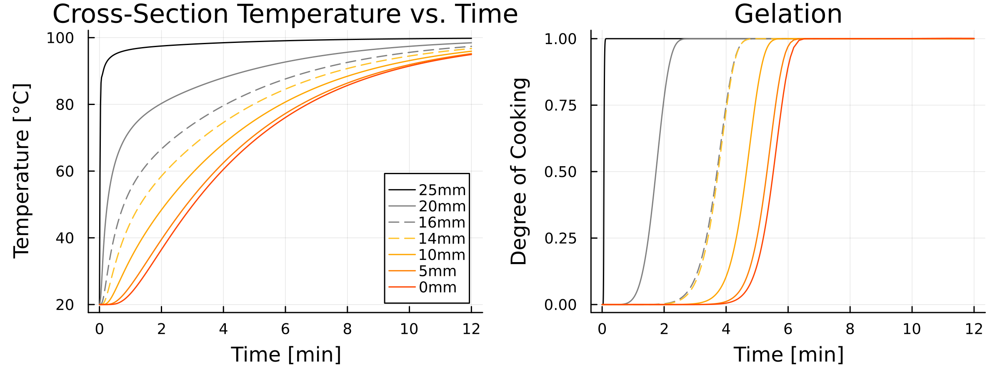

In [69]:
fig = generate_plots(sol, sol2)
# savefig("/Users/torque/web/itstorque.com/_blog_posts/2025_02_17_egg_sims/hard_boiled_egg.png")

# ylims!(fig[1], 280,  390)
# yticks!(fig[1], 280:20:390)
xticks!(0:2:12)

# plot!(fig[2], hard_boiled_sims[:, 1], hard_boiled_sims[:, [2,3,4,5,7,8,9]], color="green")

# xlims!(0, 6)

fig

In [1187]:
[hard_boiled_sims[i[1], 1] for i in findmin(abs.(hard_boiled_sims[:, [2,3,4,5,7,8,9]] .- 0.5), dims=1)[2]]

1×7 Matrix{Float64}:
 5.6  5.0  3.6  3.6  3.4  1.2  1.4

positions = [2, 1 + Integer(round((sol.prob.p.n / 2) * 0.2)), 1 + Integer(round((sol.prob.p.n / 2) * 0.36)), 1 + Integer(round((sol.prob.p.n / 2) * 0.44)), 1 + Integer(round((sol.prob.p.n / 2) * 0.6)), 1 + Integer(round((sol.prob.p.n / 2) * 0.8)), 1 + Integer(floor(sol.prob.p.n / 2)) + 0] = [2, 6, 10, 12, 16, 21, 26]


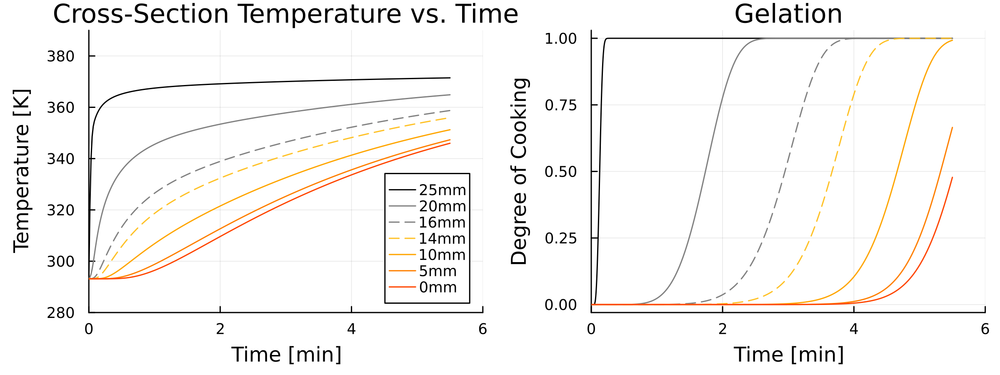

In [ ]:
sol = run_simulation(5.5*60, 2*60, 0; T_hot=100., T_cold=20., Δt=1);
sol2 = gelation_sim(sol);

fig = generate_plots(sol, sol2)
# plot!(fig[2], sous_vide_sims[:, 1], sous_vide_sims[:, [2,3,4,5,7,8,9]], color="green")


ylims!(fig[1], 280,  390)
yticks!(fig[1], 280:20:390)
xticks!(0:2:6)
xlims!(0, 6)
# ylims!(fig[1], 280, 350)
# xticks!(0:10:60)
# savefig("/Users/torque/web/itstorque.com/_blog_posts/2025_02_17_egg_sims/soft_boiled_egg.png")
fig

positions = [2, 1 + Integer(round((sol.prob.p.n / 2) * 0.2)), 1 + Integer(round((sol.prob.p.n / 2) * 0.36)), 1 + Integer(round((sol.prob.p.n / 2) * 0.44)), 1 + Integer(round((sol.prob.p.n / 2) * 0.6)), 1 + Integer(round((sol.prob.p.n / 2) * 0.8)), 1 + Integer(floor(sol.prob.p.n / 2)) + 0] = [2, 6, 10, 12, 16, 21, 26]


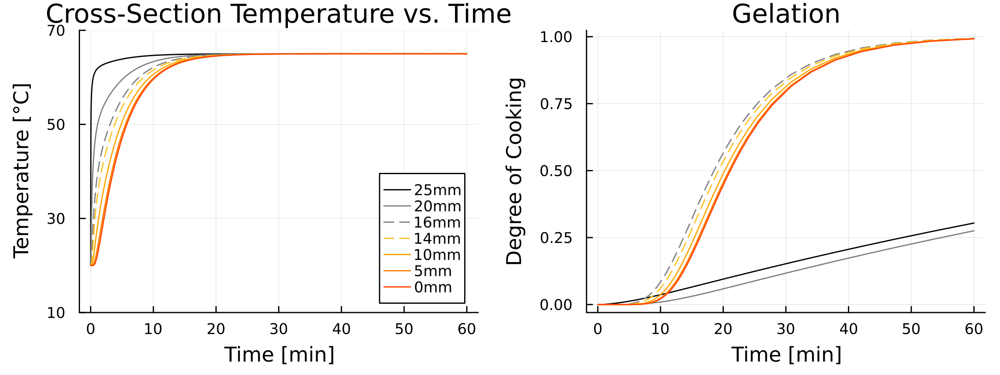

In [44]:
sol = run_simulation(60*60, 2*60, 0; T_hot=65., T_cold=20., Δt=1);
sol2 = gelation_sim(sol);

fig = generate_plots(sol, sol2)
# plot!(fig[2], sous_vide_sims[:, 1], sous_vide_sims[:, [2,3,4,5,7,8,9]], color="green")


# ylims!(fig[1], 280, 350)
# yticks!(fig[1], 280:20:350)

ylims!(fig[1], 10, 70)
yticks!(fig[1], 10:20:70)

xticks!(0:10:60)

# savefig("/Users/torque/web/itstorque.com/_blog_posts/2025_02_17_egg_sims/sous_vide_egg.png")
fig

positions = [2, 1 + Integer(round((sol.prob.p.n / 2) * 0.2)), 1 + Integer(round((sol.prob.p.n / 2) * 0.36)), 1 + Integer(round((sol.prob.p.n / 2) * 0.44)), 1 + Integer(round((sol.prob.p.n / 2) * 0.6)), 1 + Integer(round((sol.prob.p.n / 2) * 0.8)), 1 + Integer(floor(sol.prob.p.n / 2)) + 0] = [2, 6, 10, 12, 16, 21, 26]


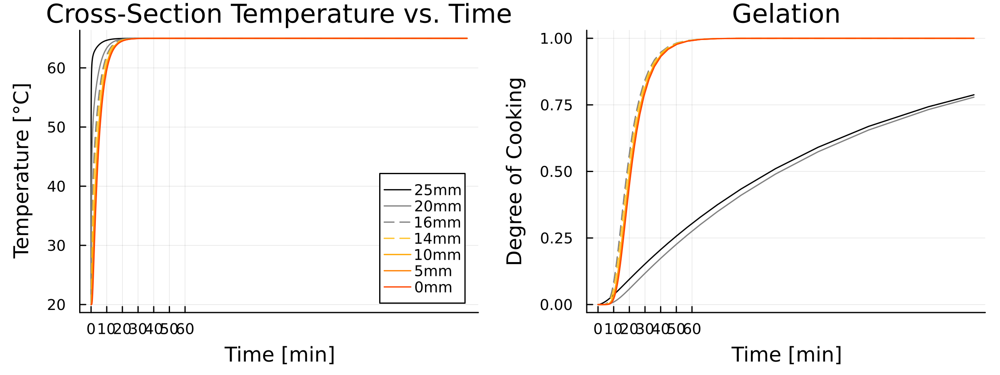

In [123]:
sol = run_simulation(4*60*60, 2*60, 0; T_hot=65., T_cold=20., Δt=1);
sol2 = gelation_sim(sol);

fig = generate_plots(sol, sol2)
# plot!(fig[2], sous_vide_sims[:, 1], sous_vide_sims[:, [2,3,4,5,7,8,9]], color="green")


# ylims!(fig[1], 280, 350)
xticks!(0:10:60)

# savefig("/Users/torque/web/itstorque.com/_blog_posts/2025_02_17_egg_sims/hold_at_70_egg.png")
fig

positions = [2, 1 + Integer(round((sol.prob.p.n / 2) * 0.2)), 1 + Integer(round((sol.prob.p.n / 2) * 0.36)), 1 + Integer(round((sol.prob.p.n / 2) * 0.44)), 1 + Integer(round((sol.prob.p.n / 2) * 0.6)), 1 + Integer(round((sol.prob.p.n / 2) * 0.8)), 1 + Integer(floor(sol.prob.p.n / 2)) + 0] = [2, 6, 10, 12, 16, 21, 26]


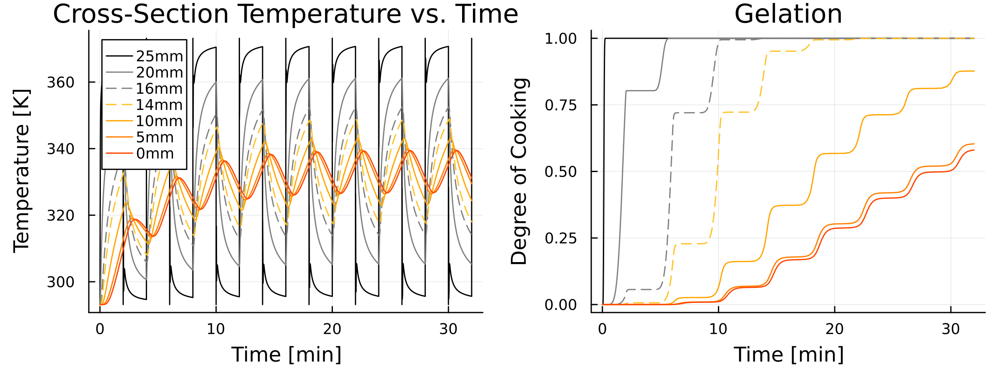

In [1412]:
sol = run_simulation(32*60, 4*60, 0.5; T_hot=100., T_cold=20., Δt=1);
sol2 = gelation_sim(sol);

fig = generate_plots(sol, sol2)

# ylims!(fig[1], 280, 350)
xticks!(0:10:60)

savefig("/Users/torque/web/itstorque.com/_blog_posts/2025_02_17_egg_sims/pulsing_egg.png")
fig

positions = [2, 1 + Integer(round((sol.prob.p.n / 2) * 0.2)), 1 + Integer(round((sol.prob.p.n / 2) * 0.36)), 1 + Integer(round((sol.prob.p.n / 2) * 0.44)), 1 + Integer(round((sol.prob.p.n / 2) * 0.6)), 1 + Integer(round((sol.prob.p.n / 2) * 0.8)), 1 + Integer(floor(sol.prob.p.n / 2)) + 0] = [2, 6, 10, 12, 16, 21, 26]


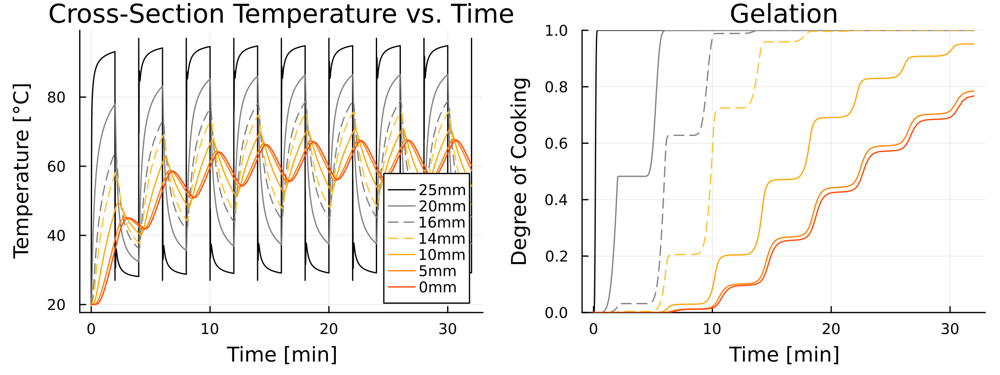

In [363]:
sol = run_simulation(32*60, 4*60, 0.5; T_hot=97., T_cold=27., Δt=1);
sol2 = gelation_sim(sol);

fig = generate_plots(sol, sol2)

# ylims!(fig[1], 280, 350)
xticks!(0:10:60)

savefig("/Users/torque/web/itstorque.com/_blog_posts/2025_02_17_egg_sims/pulsing_egg.png")
fig

positions = [2, 1 + Integer(round((sol.prob.p.n / 2) * 0.2)), 1 + Integer(round((sol.prob.p.n / 2) * 0.36)), 1 + Integer(round((sol.prob.p.n / 2) * 0.44)), 1 + Integer(round((sol.prob.p.n / 2) * 0.6)), 1 + Integer(round((sol.prob.p.n / 2) * 0.8)), 1 + Integer(floor(sol.prob.p.n / 2)) + 0] = [2, 6, 10, 12, 16, 21, 26]


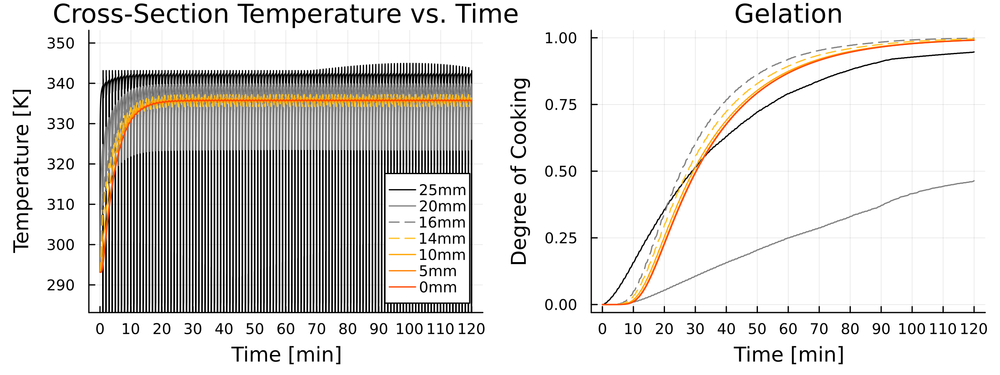

In [ ]:
sol = run_simulation(2*60*60, 1*60, 0.9; T_hot=70., T_cold=0., Δt=1);
sol2 = gelation_sim(sol);

fig = generate_plots(sol, sol2)
# plot!(fig[2], sous_vide_sims[:, 1], sous_vide_sims[:, [2,3,4,5,7,8,9]], color="green")


ylims!(fig[1], (10+273.15, 80+273.15))
xticks!(0:10:120)
# savefig("/Users/torque/web/itstorque.com/_blog_posts/2025_02_17_egg_sims/cursed_egg.png")
fig

positions = [2, 1 + Integer(round((sol.prob.p.n / 2) * 0.2)), 1 + Integer(round((sol.prob.p.n / 2) * 0.36)), 1 + Integer(round((sol.prob.p.n / 2) * 0.44)), 1 + Integer(round((sol.prob.p.n / 2) * 0.6)), 1 + Integer(round((sol.prob.p.n / 2) * 0.8)), 1 + Integer(floor(sol.prob.p.n / 2)) + 0] = [2, 6, 10, 12, 16, 21, 26]


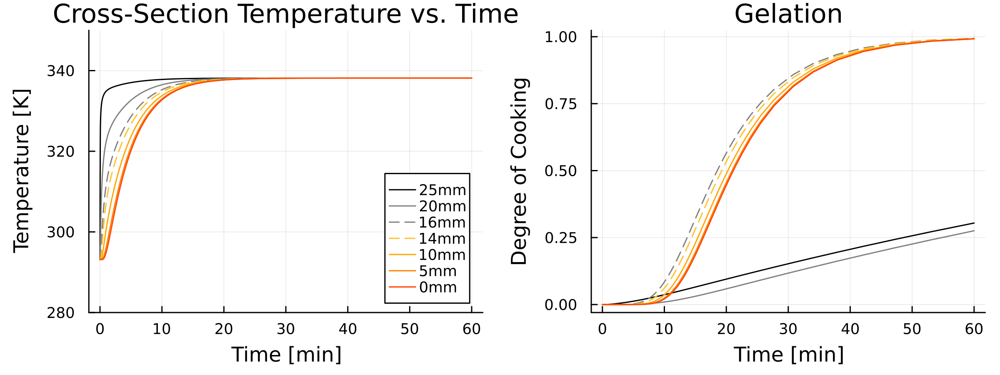

In [ ]:
sol = run_simulation_sin(60*60, 150*60, 0.; T_hot=65., Δt=1);
sol2 = gelation_sim(sol);

fig = generate_plots(sol, sol2)
# plot!(fig[2], sous_vide_sims[:, 1], sous_vide_sims[:, [2,3,4,5,7,8,9]], color="green")


ylims!(fig[1], 280, 350)
yticks!(fig[1], 280:20:350)
xticks!(0:10:60)

positions = [2, 1 + Integer(round((sol.prob.p.n / 2) * 0.2)), 1 + Integer(round((sol.prob.p.n / 2) * 0.36)), 1 + Integer(round((sol.prob.p.n / 2) * 0.44)), 1 + Integer(round((sol.prob.p.n / 2) * 0.6)), 1 + Integer(round((sol.prob.p.n / 2) * 0.8)), 1 + Integer(floor(sol.prob.p.n / 2)) + 0] = [2, 6, 10, 12, 16, 21, 26]


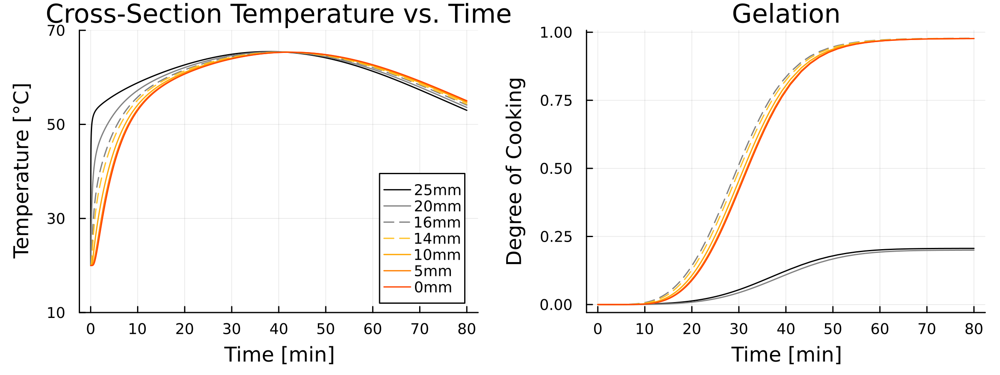

In [72]:
sol = run_simulation_sin(80*60, 150*60, 10.5; T_hot=55., Δt=1);
sol2 = gelation_sim(sol);

fig = generate_plots(sol, sol2)
# plot!(fig[2], sous_vide_sims[:, 1], sous_vide_sims[:, [2,3,4,5,7,8,9]], color="green")


# ylims!(fig[1], 280, 350)
# yticks!(fig[1], 280:20:350)

ylims!(fig[1], 10, 70)
yticks!(fig[1], 10:20:70)

xticks!(0:10:80)

# savefig("/Users/torque/web/itstorque.com/_blog_posts/2025_02_17_egg_sims/cursed_sin_egg.png")
fig

positions = [2, 1 + Integer(round((sol.prob.p.n / 2) * 0.2)), 1 + Integer(round((sol.prob.p.n / 2) * 0.36)), 1 + Integer(round((sol.prob.p.n / 2) * 0.44)), 1 + Integer(round((sol.prob.p.n / 2) * 0.6)), 1 + Integer(round((sol.prob.p.n / 2) * 0.8)), 1 + Integer(floor(sol.prob.p.n / 2)) + 0] = [2, 6, 10, 12, 16, 21, 26]


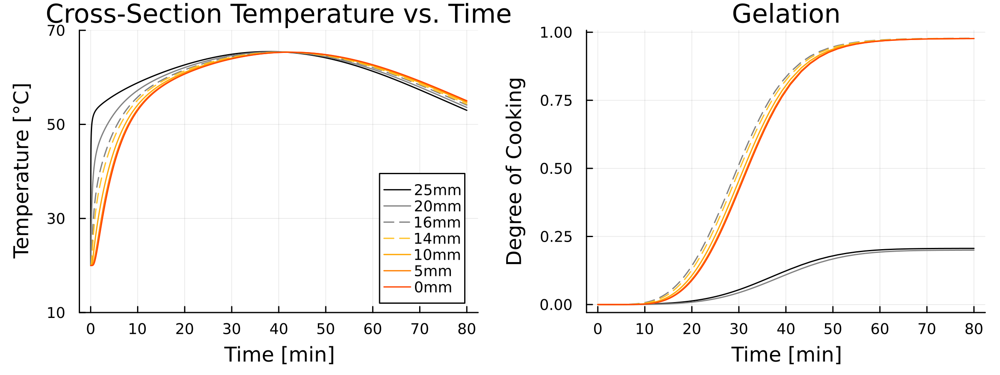

In [84]:
sol = run_simulation_sin(80*60, 150*60, 10.5; T_hot=55., Δt=1);
sol2 = gelation_sim(sol);

fig = generate_plots(sol, sol2)

ylims!(fig[1], 10, 70)
yticks!(fig[1], 10:20:70)

xticks!(0:10:80)

fig

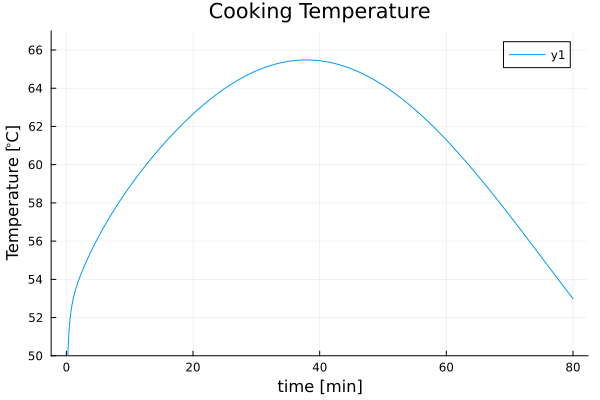

In [85]:
plot(sol.t/60, hcat(sol.u...)[2, :], title="Cooking Temperature")
xlabel!("time [min]")
ylabel!("Temperature [\$\\degree\$C]")
ylims!(50, 67)
yticks!(50:2:67)

In [86]:
maximum(hcat(sol.u...)[2, :])

65.47716459152922

In [87]:
# convert deg Celsius to deg Fahrenheit
cel_to_fahr(c) = c * 9/5 + 32

cel_to_fahr (generic function with 1 method)

In [ ]:
my_profile = hcat(sol(60 .* (0:5:80))...)[2, :][2:end]

16-element Vector{Float64}:
 56.176208661167976
 58.848994797362835
 60.94358673671424
 62.64971648597007
 63.98209931153343
 64.90987427670348
 65.40078633660579
 65.43591726379475
 65.0145580617922
 64.1554455029674
 62.89629031666692
 61.29222052378564
 59.4133909579029
 57.34191933089362
 55.168299824
 52.98745563494984

In [88]:
cel_to_fahr.(hcat(sol(60 .* (0:5:80))...)[2, :])

17-element Vector{Float64}:
  68.0
 133.11717559010236
 137.9281906352531
 141.69845612608563
 144.76948967474613
 147.16777876076017
 148.83777369806626
 149.7214154058904
 149.78465107483055
 149.02620451122596
 147.4798019053413
 145.21332257000046
 142.32599694281413
 138.94410372422522
 135.2154547956085
 131.3029396832
 127.3774201429097

positions = [2, 1 + Integer(round((sol.prob.p.n / 2) * 0.2)), 1 + Integer(round((sol.prob.p.n / 2) * 0.36)), 1 + Integer(round((sol.prob.p.n / 2) * 0.44)), 1 + Integer(round((sol.prob.p.n / 2) * 0.6)), 1 + Integer(round((sol.prob.p.n / 2) * 0.8)), 1 + Integer(floor(sol.prob.p.n / 2)) + 0] = [2, 6, 10, 12, 16, 21, 26]


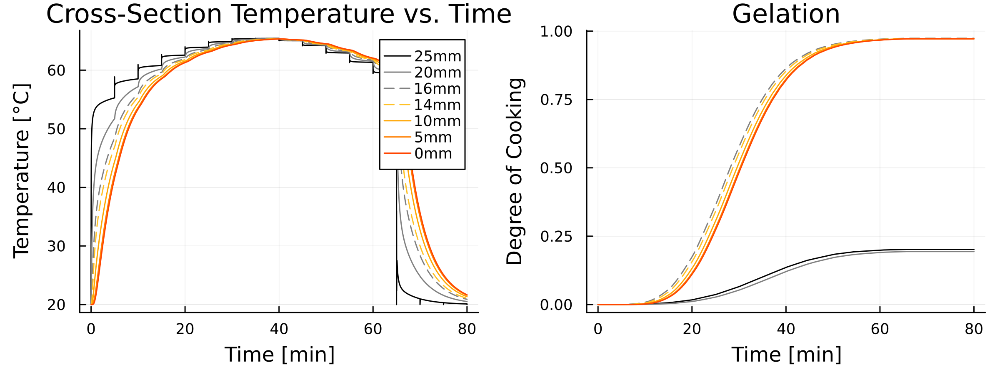

In [122]:
test = run_simulation_steps(80*60, 5*60, vcat(my_profile[1:end-3], repeat([20], 5))
                            ; Δt=1)
# test = run_simulation_steps(32*60, 2*60, repeat([100., 20.], 16); Δt=1)

test2 = gelation_sim(test);

fig = generate_plots(test, test2)
# plot!(fig[2], sous_vide_sims[:, 1], sous_vide_sims[:, [2,3,4,5,7,8,9]], color="green")


# ylims!(fig[1], 280,  390)
# yticks!(fig[1], 280:20:390)
# ylims!(fig[1], 10, 100)
# yticks!(fig[1], 10:20:100)
# xticks!(vcat(0:4:12, [20, 30]))

# savefig("/Users/torque/web/itstorque.com/_blog_posts/2025_02_17_egg_sims/faster_pulsing_egg.png")


# ylims!(fig[1], 280, 350)
# xticks!(0:10:60)
fig

positions = [2, 1 + Integer(round((sol.prob.p.n / 2) * 0.2)), 1 + Integer(round((sol.prob.p.n / 2) * 0.36)), 1 + Integer(round((sol.prob.p.n / 2) * 0.44)), 1 + Integer(round((sol.prob.p.n / 2) * 0.6)), 1 + Integer(round((sol.prob.p.n / 2) * 0.8)), 1 + Integer(floor(sol.prob.p.n / 2)) + 0] = [2, 6, 10, 12, 16, 21, 26]


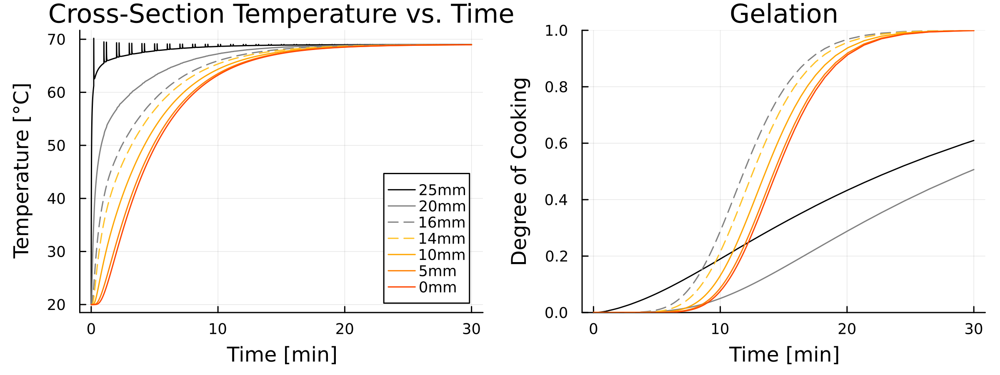

In [290]:
sol = run_simulation(30*60, 60, 0.2; T_hot=69., T_cold=69., Δt=0.1);
sol2 = gelation_sim(sol);

fig = generate_plots(sol, sol2)
fig

positions = [2, 1 + Integer(round((sol.prob.p.n / 2) * 0.2)), 1 + Integer(round((sol.prob.p.n / 2) * 0.36)), 1 + Integer(round((sol.prob.p.n / 2) * 0.44)), 1 + Integer(round((sol.prob.p.n / 2) * 0.6)), 1 + Integer(round((sol.prob.p.n / 2) * 0.8)), 1 + Integer(floor(sol.prob.p.n / 2)) + 0] = [2, 6, 10, 12, 16, 21, 26]


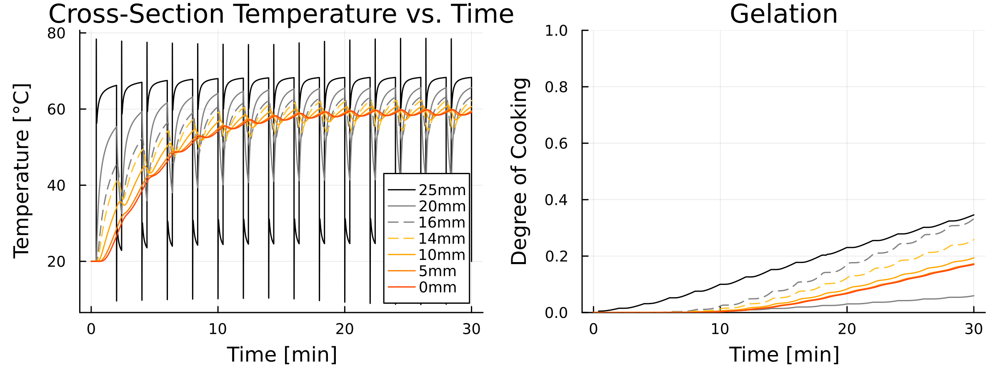

In [293]:
sol = run_simulation(30*60, 60, 0.4; T_hot=20., T_cold=69., Δt=0.1);
sol2 = gelation_sim(sol);

fig = generate_plots(sol, sol2)
fig

positions = [2, 1 + Integer(round((sol.prob.p.n / 2) * 0.2)), 1 + Integer(round((sol.prob.p.n / 2) * 0.36)), 1 + Integer(round((sol.prob.p.n / 2) * 0.44)), 1 + Integer(round((sol.prob.p.n / 2) * 0.6)), 1 + Integer(round((sol.prob.p.n / 2) * 0.8)), 1 + Integer(floor(sol.prob.p.n / 2)) + 0] = [2, 6, 10, 12, 16, 21, 26]


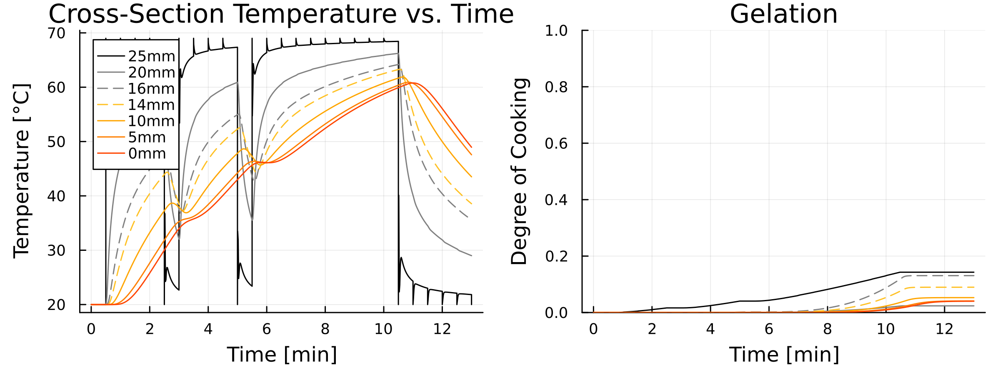

In [280]:
let
    time_step = 0.5
    Th, Tc = 69, 20
    cursed_begin_profile = repeat([Tc, Th, Th, Th, Th], 3)
    cursed_new_profile = [Th, Th, Th, Th, Th, Th] #repeat([Th, Th, Th, Th, Th, Th], 5)

    test = run_simulation_steps((length(cursed_begin_profile) + length(cursed_new_profile) + 5)*time_step*60, time_step*60, vcat(cursed_begin_profile, cursed_new_profile, repeat([20], 5))
                                ; Δt=1)
    # test = run_simulation_steps(32*60, 2*60, repeat([100., 20.], 16); Δt=1)

    test2 = gelation_sim(test);

    fig = generate_plots(test, test2)
    # plot!(fig[2], sous_vide_sims[:, 1], sous_vide_sims[:, [2,3,4,5,7,8,9]], color="green")


    # ylims!(fig[1], 280,  390)
    # yticks!(fig[1], 280:20:390)
    # ylims!(fig[1], 10, 100)
    # yticks!(fig[1], 10:20:100)
    # xticks!(vcat(0:4:12, [20, 30]))

    # savefig("/Users/torque/web/itstorque.com/_blog_posts/2025_02_17_egg_sims/faster_pulsing_egg.png")


    # ylims!(fig[1], 280, 350)
    # xticks!(0:10:60)
    display(fig)
end;

positions = [2, 1 + Integer(round((sol.prob.p.n / 2) * 0.2)), 1 + Integer(round((sol.prob.p.n / 2) * 0.36)), 1 + Integer(round((sol.prob.p.n / 2) * 0.44)), 1 + Integer(round((sol.prob.p.n / 2) * 0.6)), 1 + Integer(round((sol.prob.p.n / 2) * 0.8)), 1 + Integer(floor(sol.prob.p.n / 2)) + 0] = [2, 6, 10, 12, 16, 21, 26]


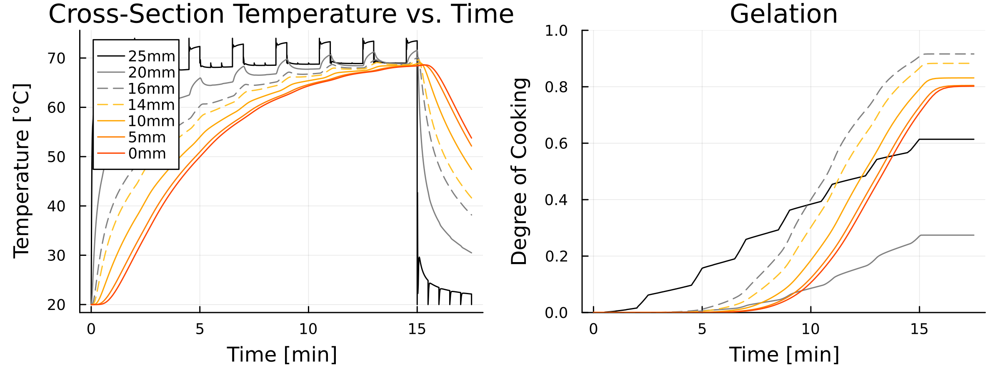

positions = [2, 1 + Integer(round((sol.prob.p.n / 2) * 0.2)), 1 + Integer(round((sol.prob.p.n / 2) * 0.36)), 1 + Integer(round((sol.prob.p.n / 2) * 0.44)), 1 + Integer(round((sol.prob.p.n / 2) * 0.6)), 1 + Integer(round((sol.prob.p.n / 2) * 0.8)), 1 + Integer(floor(sol.prob.p.n / 2)) + 0] = [2, 6, 10, 12, 16, 21, 26]


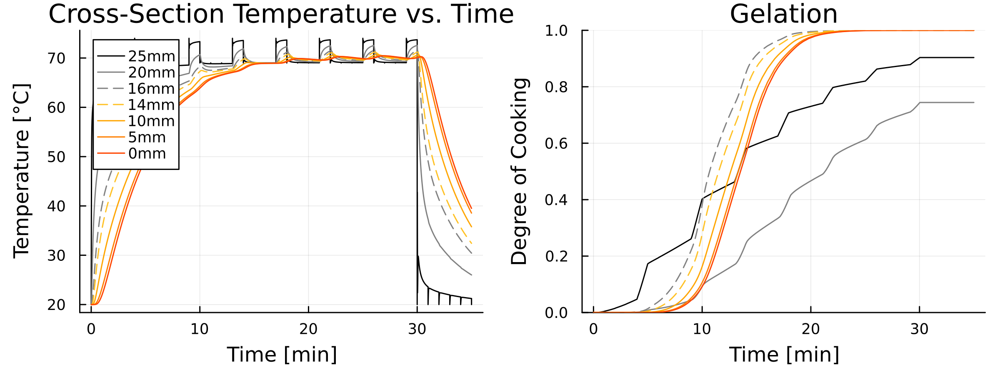

positions = [2, 1 + Integer(round((sol.prob.p.n / 2) * 0.2)), 1 + Integer(round((sol.prob.p.n / 2) * 0.36)), 1 + Integer(round((sol.prob.p.n / 2) * 0.44)), 1 + Integer(round((sol.prob.p.n / 2) * 0.6)), 1 + Integer(round((sol.prob.p.n / 2) * 0.8)), 1 + Integer(floor(sol.prob.p.n / 2)) + 0] = [2, 6, 10, 12, 16, 21, 26]


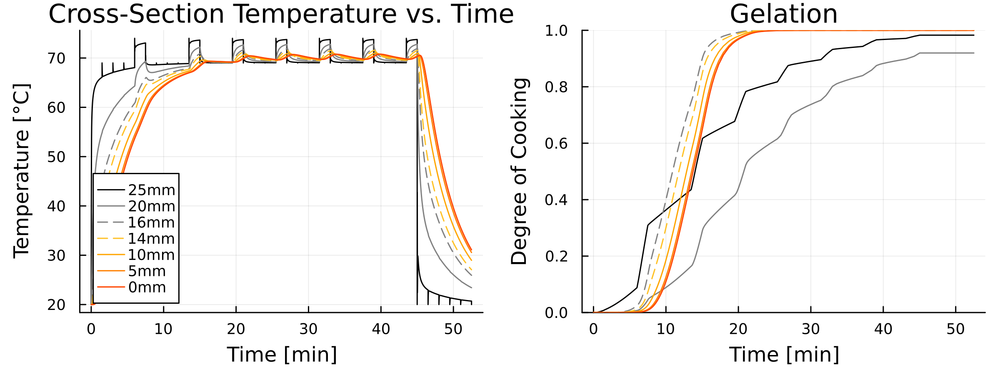

positions = [2, 1 + Integer(round((sol.prob.p.n / 2) * 0.2)), 1 + Integer(round((sol.prob.p.n / 2) * 0.36)), 1 + Integer(round((sol.prob.p.n / 2) * 0.44)), 1 + Integer(round((sol.prob.p.n / 2) * 0.6)), 1 + Integer(round((sol.prob.p.n / 2) * 0.8)), 1 + Integer(floor(sol.prob.p.n / 2)) + 0] = [2, 6, 10, 12, 16, 21, 26]


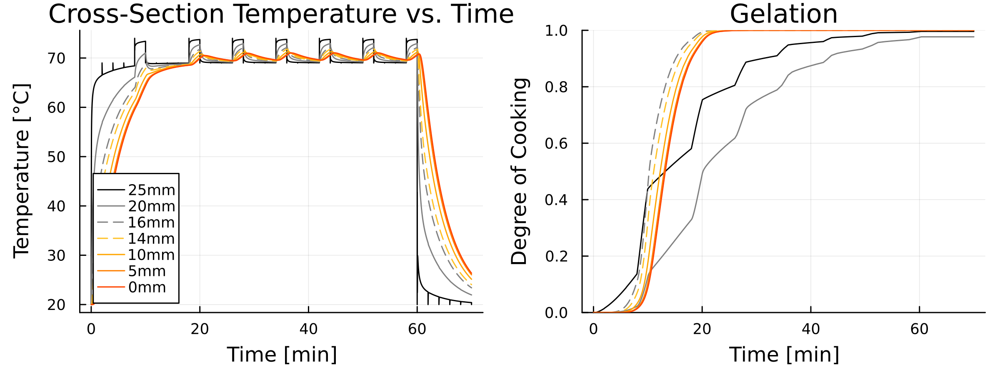

In [281]:
for time_step in [0.5, 1, 1.5, 2]
    Th, Tc = 74, 69
    cursed_begin_profile = repeat([Tc, Tc, Tc, Tc, Th], 2)
    cursed_new_profile = repeat([Tc, Tc, Tc, Th], 5)

    test = run_simulation_steps((length(cursed_begin_profile) + length(cursed_new_profile) + 5)*time_step*60, time_step*60, vcat(cursed_begin_profile, cursed_new_profile, repeat([20], 5))
                                ; Δt=1)
    # test = run_simulation_steps(32*60, 2*60, repeat([100., 20.], 16); Δt=1)

    test2 = gelation_sim(test);

    fig = generate_plots(test, test2)
    # plot!(fig[2], sous_vide_sims[:, 1], sous_vide_sims[:, [2,3,4,5,7,8,9]], color="green")


    # ylims!(fig[1], 280,  390)
    # yticks!(fig[1], 280:20:390)
    # ylims!(fig[1], 10, 100)
    # yticks!(fig[1], 10:20:100)
    # xticks!(vcat(0:4:12, [20, 30]))

    # savefig("/Users/torque/web/itstorque.com/_blog_posts/2025_02_17_egg_sims/faster_pulsing_egg.png")


    # ylims!(fig[1], 280, 350)
    # xticks!(0:10:60)
    display(fig)
end;

In [362]:
n=5
time_step = 2

min_loss = 100_000
min_sol = nothing

Th, Tc = 69, 74

for i = 1:2^(n+1)-1
    s = bitstring(i)
    pulse = [(i=='0' ? Tc : Th) for i in s[length(s)-n:end]]
    pulse |> print
    " -> " |> print

    pulse = repeat(pulse, 10)

    test = run_simulation_steps((length(pulse) + 5)*time_step*60, time_step*60, vcat([20], pulse, repeat([20], 5)) ; Δt=1)
    test2 = gelation_sim(test);

    # loss = (sum(test2.u[end][1:9])^2 + (16 - sum(test2.u[end][10:25]))^2)
    loss = minimum([sum(i[1:9])^2 + (16 - sum(i[10:25]))^2 for i in test2.u])

    if loss < min_loss
        min_loss = loss
        min_sol = pulse
    end

    loss |> println;
end

min_loss

# timestep 0.5
    # 16 for 74, 69
    # 38 for 74, 20
    # 13.4 for 69, 20

[74, 74, 74, 74, 74, 69] -> 31.491990103287556
[74, 74, 74, 74, 69, 74] -> 34.535055314063804
[74, 74, 74, 74, 69, 69] -> 30.556360180788413
[74, 74, 74, 69, 74, 74] -> 35.73036456853944
[74, 74, 74, 69, 74, 69] -> 30.65109581491454
[74, 74, 74, 69, 69, 74] -> 33.18529137197012
[74, 74, 74, 69, 69, 69] -> 29.907884359301057
[74, 74, 69, 74, 74, 74] -> 36.5855829512533
[74, 74, 69, 74, 74, 69] -> 31.103215007530753
[74, 74, 69, 74, 69, 74] -> 33.45828467728094
[74, 74, 69, 74, 69, 69] -> 29.95936669865667
[74, 74, 69, 69, 74, 74] -> 34.736847300539615
[74, 74, 69, 69, 74, 69] -> 30.384274019605897
[74, 74, 69, 69, 69, 74] -> 32.364186899179295
[74, 74, 69, 69, 69, 69] -> 29.27845072152497
[74, 69, 74, 74, 74, 74] -> 37.279252959119574
[74, 69, 74, 74, 74, 69] -> 31.434679914914362
[74, 69, 74, 74, 69, 74] -> 34.04802489639271
[74, 69, 74, 74, 69, 69] -> 26.955637206916606
[74, 69, 74, 69, 74, 74] -> 35.15630845737264
[74, 69, 74, 69, 74, 69] -> 28.08465768602292
[74, 69, 74, 69, 69, 74]

13.297144214647606

In [ ]:
Threads.@threads for i in 1:10

end

positions = [2, 1 + Integer(round((sol.prob.p.n / 2) * 0.2)), 1 + Integer(round((sol.prob.p.n / 2) * 0.36)), 1 + Integer(round((sol.prob.p.n / 2) * 0.44)), 1 + Integer(round((sol.prob.p.n / 2) * 0.6)), 1 + Integer(round((sol.prob.p.n / 2) * 0.8)), 1 + Integer(floor(sol.prob.p.n / 2)) + 0] = [2, 6, 10, 12, 16, 21, 26]


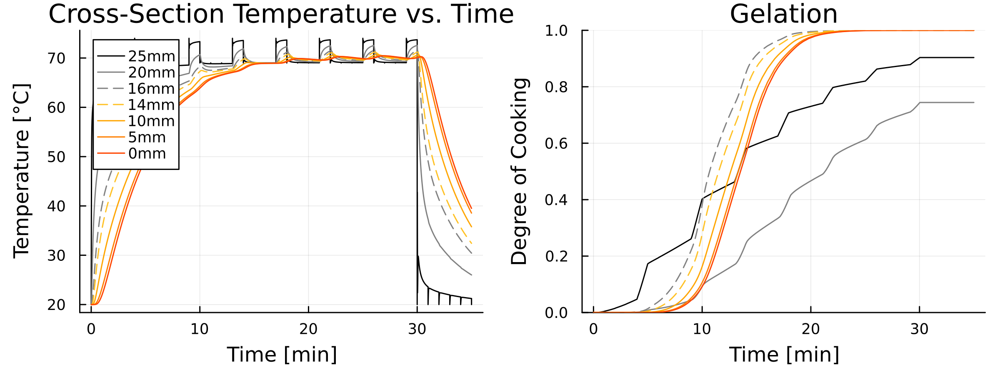

(7.185462963093945, 10.999792465698997)

In [337]:
# for 
Th, Tc = 74, 69
cursed_begin_profile = repeat([Tc, Tc, Tc, Tc, Th], 2)
cursed_new_profile = repeat([Tc, Tc, Tc, Th], 5)

test = run_simulation_steps((length(cursed_begin_profile) + length(cursed_new_profile) + 5)*time_step*60, time_step*60, vcat(cursed_begin_profile, cursed_new_profile, repeat([20], 5))
                            ; Δt=1)
# test = run_simulation_steps(32*60, 2*60, repeat([100., 20.], 16); Δt=1)

test2 = gelation_sim(test);

fig = generate_plots(test, test2)

display(fig)

sum(test2.u[end][1:9]), sum(test2.u[end][15:25])

In [304]:
sol.prob.p

(n = 50, n_yolk = 30, thermal_state = 0.0)

In [57]:
using Interpolations

# interp_linear = linear_interpolation(sol.t/60, hcat(sol.u...)[2, :])
linear_interpolation

LoadError: UndefVarError: `linear_interpolation` not defined in `Main`
Suggestion: check for spelling errors or missing imports.

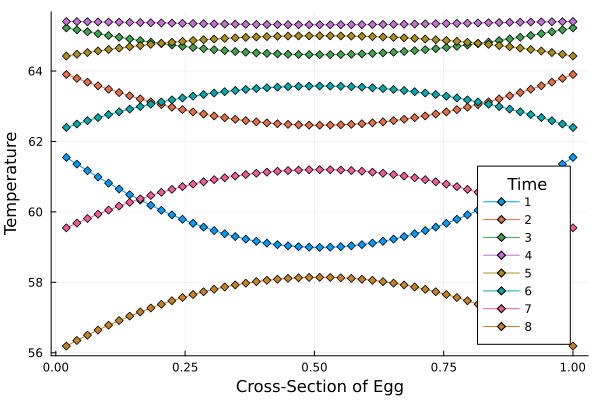

In [1314]:
p1 = Plots.plot(ylabel="Temperature", xlabel="Cross-Section of Egg", legend_title="Time")
for (idx, tvec) in enumerate(sol.u[1000:Integer(floor(end//10)):end])
    Plots.plot!(zf[2:end], tvec[2:end-1], label = idx, markershape = :diamond)
end
p1

# plot(zf[1:end-1], sol.u[2][2:end-1], markershape = :diamond)

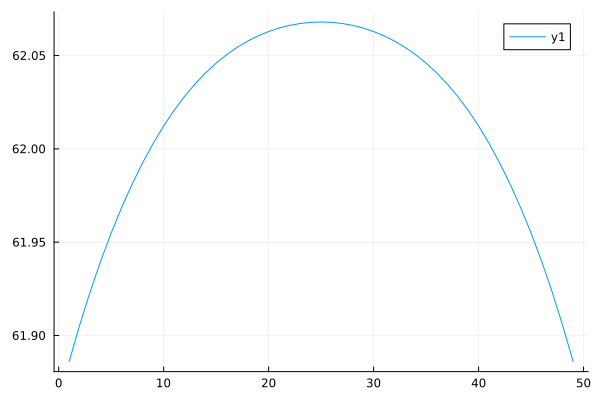

In [1293]:
zf = range(0, 1, length=sol.prob.p[:n])

# Plots.plot!(zf[2:end-1], tvec[2:end-1], label = idx, markershape = :diamond)
# plot(zf[2:end-1], median(hcat(sol.u...)[2:end-1, :]; dims=2), label="simulation", ylabel="Median Temperature", title="Median Temperature While Cooking Egg", xlabel="Position in Egg")

plot( mean(hcat(sol.u...)[2:end-1, 800:end]; dims=2) )

# vline!(zf[[1 + div(sol.prob.p[:n] - 1, 2) - div(sol.prob.p[:n_yolk], 2), 1 + div(sol.prob.p[:n] - 1, 2) + div(sol.prob.p[:n_yolk], 2)]], label="Egg Yolk")

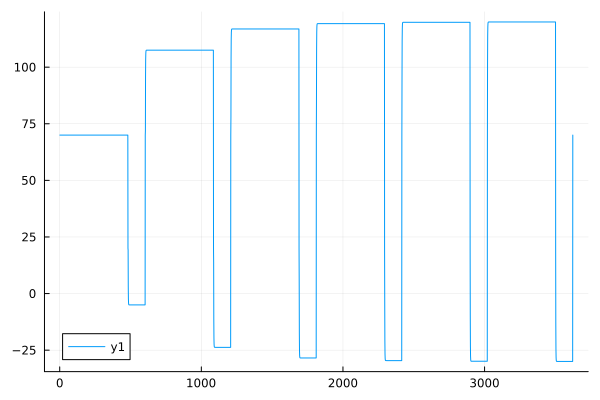

In [1178]:
plot(hcat(sol.u...)[1, :])

positions = [1, 1 + Integer(round((sol.prob.p.n / 2) * 0.2)), 1 + Integer(round((sol.prob.p.n / 2) * 0.36)), 1 + Integer(round((sol.prob.p.n / 2) * 0.44)), 1 + Integer(round((sol.prob.p.n / 2) * 0.6)), 1 + Integer(round((sol.prob.p.n / 2) * 0.8)), 1 + Integer(floor(n / 2)) + 0] = [1, 6, 10, 12, 16, 21, 26]


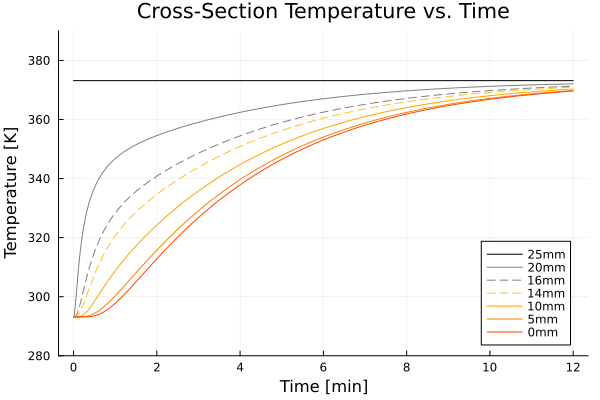

In [ ]:
p1 = Plots.plot(; xlabel="Time [min]", 
ylabel = plot_in_kelvin ? "Temperature [K]" : "Temperature [°C]", 
title="Cross-Section Temperature vs. Time")

@show positions = [
    1,
    1 + Integer(round(sol.prob.p.n / 2 * 0.2)),
    1 + Integer(round(sol.prob.p.n / 2 * 0.36)),
    1 + Integer(round(sol.prob.p.n / 2 * 0.44)),

    1 + Integer(round(sol.prob.p.n / 2 * 0.6)),
    1 + Integer(round(sol.prob.p.n / 2 * 0.8)),
    1 + Integer(floor(n/2)) + 0
]

labels = [
    "25mm",
    "20mm",
    "16mm",
    "14mm",
    "10mm",
    "5mm",
    "0mm"
]

colors = [
    :black,
    :grey,
    :grey,
    :goldenrod1,
    :orange,
    :darkorange1,
    :orangered
]

styles = [
    :solid,
    :solid,
    :dash,
    :dash,
    :solid,
    :solid,
    :solid
]

for (i, pos) in enumerate(positions)
    Plots.plot!(sol.t/60, temperature_offset .+ hcat(sol.u...)[pos, :], label=labels[i], color=colors[i], style=styles[i])
end

# 
# Plots.plot!(sol.t/60, hcat(sol.u...)[2, :], label="0mm", color=:grey)
# Plots.plot!(sol.t, hcat(sol.u...)[3, :], label="albumen", color=:grey)
# Plots.plot!(sol.t/60, temperature_offset .+ hcat(sol.u...)[Integer(round(sol.prob.p.n / 2 * 0.2)), :], label="20mm", color=:grey)
# Plots.plot!(sol.t/60, temperature_offset .+ hcat(sol.u...)[Integer(round(sol.prob.p.n / 2 * 0.36)), :], label="16mm", color=:grey)
# # Plots.plot!(hcat(sol.u...)[5, :], label="albumen", color=:grey)
# # Plots.plot!(hcat(sol.u...)[Integer(floor(n/2)) - 2, :], label="yolk", color=:orange)
# Plots.plot!(sol.t/60, temperature_offset .+ hcat(sol.u...)[Integer(round(sol.prob.p.n / 2 * 0.44)), :], label="14mm", color=:orange)

# Plots.plot!(sol.t/60, temperature_offset .+ hcat(sol.u...)[Integer(round(sol.prob.p.n / 2 * 0.6)), :], label="10mm", color=:orange)

# Plots.plot!(sol.t/60, temperature_offset .+ hcat(sol.u...)[Integer(round(sol.prob.p.n / 2 * 0.8)), :], label="5mm", color=:orange)
# Plots.plot!(sol.t/60, temperature_offset .+ hcat(sol.u...)[Integer(floor(n/2)) + 0, :], label="yolk", color=:orange)
# Plots.plot!(sol.t/60, temperature_offset .+ hcat(sol.u...)[Integer(round(sol.prob.p.n / 2 * 0.8)), label="yolk", color=:orange)
# Plots.plot!(hcat(sol.u...)[Integer(floor(n/2)) + 2, :], label="yolk", color=:orange)
# Plots.plot!(hcat(sol.u...)[n-3, :], label="albumen", color=:black)
# Plots.plot!(sol.t, hcat(sol.u...)[n-2, :], label="albumen", color=:black)
# Plots.plot!(sol.t, hcat(sol.u...)[n-1, :], label="albumen", color=:black)
# Plots.plot!(hcat(sol.u...)[n, :], label="albumen", color=:black)

ylims!(280,  390)
yticks!(280:20:390)
xticks!(0:2:12)
# vline!([4], label=nothing)
# hline!([318], label=nothing)

# ylims!(260-270,  400-270)

In [521]:
Ai_albumen, Eai_albumen = 2.72e50, 3.443e5 # s^-1 and J
Ai_yolk, Eai_yolk       = 4.85e60, 4.185e5 # s^-1 and J

R = 8.3144598 # J⋅mol^−1⋅K^−1

n, n_yolk, _ = sol.prob.p

i1, i2 = 1 + div(n - 1, 2) - div(n_yolk, 2), 1 + div(n - 1, 2) + div(n_yolk, 2)

Ai_vec = Ai_albumen * ones(n+1)
Ai_vec[i1:i2] .= Ai_yolk

Eai_vec = Eai_albumen * ones(n+1)
Eai_vec[i1:i2] .= Eai_yolk

function cooking!(du, u, p, t)
    temp = sol(t) .+ 273.15
    du .= Ai_vec .* exp.(-Eai_vec ./ (R .* (temp))) .* (1 .- u)
end

u0 = zeros(length(sol.u[1]))
cooking_prob = ODEProblem(cooking!, u0, (sol.t[1], sol.t[end]))
sol2 = solve(cooking_prob, Rosenbrock23())#Tsit5())

retcode: Success
Interpolation: specialized 2nd order "free" stiffness-aware interpolation
t: 353-element Vector{Float64}:
   0.0
   1.2950101453138805e-6
   1.4245111598452684e-5
   8.845482832497545e-5
   0.000205639101742629
   0.00044916357649719756
   0.0007943126291779767
   0.001347595471145237
   0.00207000428640197
   0.0030718449650450584
   0.004312426478795119
   0.005901357964409797
   0.007816981092917851
   ⋮
 372.5912201135456
 377.73911767982304
 384.4757055884638
 395.78474789666444
 404.06478430135087
 424.2173714322317
 460.33466315602095
 574.2791084589257
 611.2468046652756
 653.8297216959876
 696.4126387266996
 720.0
u: 353-element Vector{Vector{Float64}}:
 [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0  …  0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
 [0.00022469129657410984, 1.582236833858004e-17, 1.5822280554980022e-17, 1.58222448756697e-17, 1.5822230508902428e-17, 1.5822224747289547e-17, 1.5822222440401905e-17, 1.5822221517313808e-17, 1.58222211479526

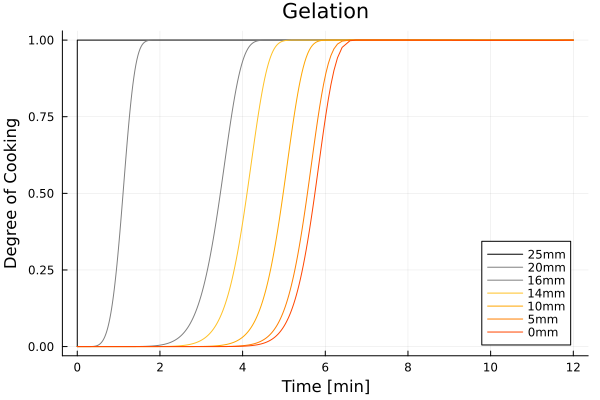

In [527]:
p2 = plot(title="Gelation", xlabel="Time [min]", ylabel="Degree of Cooking")

for (i, pos) in enumerate(positions)
    plot!(sol2.t/60, hcat(sol2.u...)[pos, :], label=labels[i], color=colors[i])
end
# plot!(sol2.t/60, hcat(sol2.u...)[3, :])
# # plot!(sol2.t/60, hcat(sol2.u...)[6, :])
# plot!(sol2.t/60, hcat(sol2.u...)[10, :])
# plot!(sol2.t/60, hcat(sol2.u...)[20, :])
# plot!(sol2.t/60, hcat(sol2.u...)[25, :])

xticks!(0:2:12)
plot!()

In [528]:
plot(p1, p2, layout=(1, 2), size=(800, 300), dpi=300, left_margin = 5Plots.mm, bottom_margin=5Plots.mm)
savefig("/Users/torque/web/itstorque.com/_blog_posts/2025_02_17_egg_sims/hard_boiled_egg.png")

"/Users/torque/web/itstorque.com/_blog_posts/2025_02_17_egg_sims/hard_boiled_egg.png"

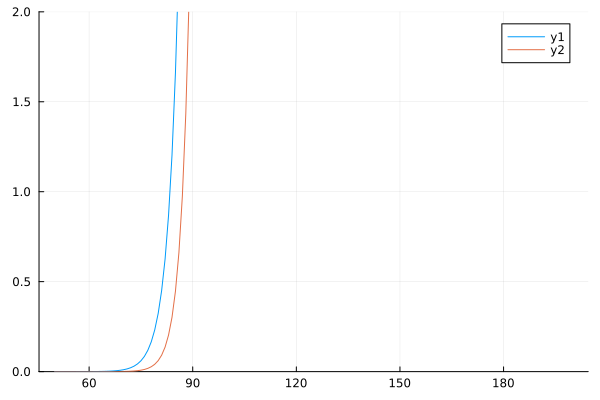

In [345]:
temp_sweep = 50.:1.:200.

plot()

plot!(temp_sweep, (Ai_albumen .* (exp.(-Eai_albumen ./ (R .* (temp_sweep .+ 273.15))))))
plot!(temp_sweep, (Ai_yolk .* exp.(-Eai_yolk ./ (R .* (temp_sweep .+ 273.15)))))

# plot!(yscale=:log)
# plot!(temp_sweep, (-Eai_albumen ./ (R .* (temp_sweep))))
# plot!(temp_sweep, (-Eai_yolk ./ (R .* (temp_sweep))))

# hline!([0])
ylims!(0, 2)

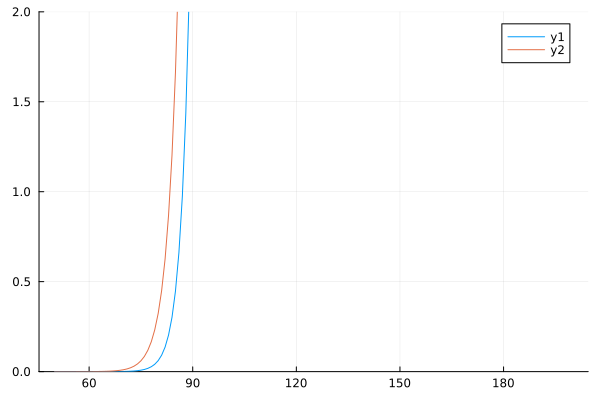

In [137]:
temp_sweep = 50.:1.:200.

plot()

plot!(temp_sweep, (Ai_albumen .* (exp.(-Eai_albumen ./ (R .* (temp_sweep .+ 273.15))))))
plot!(temp_sweep, (Ai_yolk .* exp.(-Eai_yolk ./ (R .* (temp_sweep .+ 273.15)))))

# plot!(yscale=:log)
# plot!(temp_sweep, (-Eai_albumen ./ (R .* (temp_sweep))))
# plot!(temp_sweep, (-Eai_yolk ./ (R .* (temp_sweep))))

# hline!([0])
ylims!(0, 2)

In [1]:
plot_in_kelvin = false
temperature_offset = plot_in_kelvin ? 273.15 : 0

Plots.plot(sol.t/60, temperature_offset .+ hcat(sol.u...)[1, :], title="Drive Temperature")
Plots.plot!(sol.t/60,temperature_offset .+ hcat(sol.u...)[n+1, :])

LoadError: UndefVarError: `sol` not defined in `Main`
Suggestion: check for spelling errors or missing imports.

In [58]:
# Plots.plot!(zf[2:end-1], tvec[2:end-1], label = idx, markershape = :diamond)
plot(zf[2:end-1], median(hcat(sol.u...)[2:end-1, :]; dims=2), ylabel="Aggregate Simulated Temperature", label="Median Temperature", xlabel="Position in Egg")
plot!(zf[2:end-1], mean(hcat(sol.u...)[2:end-1, :]; dims=2), label="Mean Temperature")

vline!(zf[[1 + div(n - 1, 2) - div(n_yolk, 2), 1 + div(n - 1, 2) + div(n_yolk, 2)]], label="Egg Yolk")

LoadError: UndefVarError: `zf` not defined in `Main`
Suggestion: check for spelling errors or missing imports.

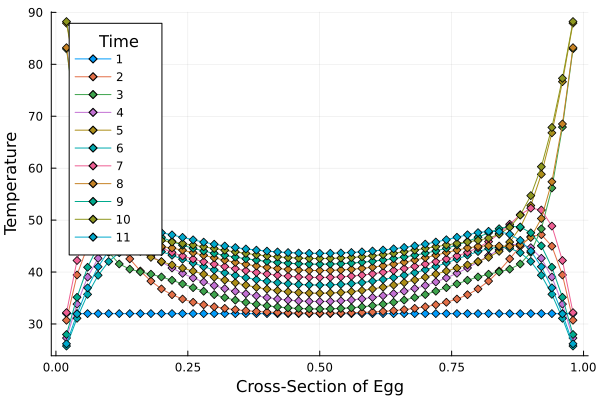

In [1222]:
p1 = Plots.plot(ylabel="Temperature", xlabel="Cross-Section of Egg", legend_title="Time")
for (idx, tvec) in enumerate(sol.u[1:Integer(floor(end//10)):end])
    Plots.plot!(zf[2:end-1], tvec[2:end-1], label = idx, markershape = :diamond)
end
p1

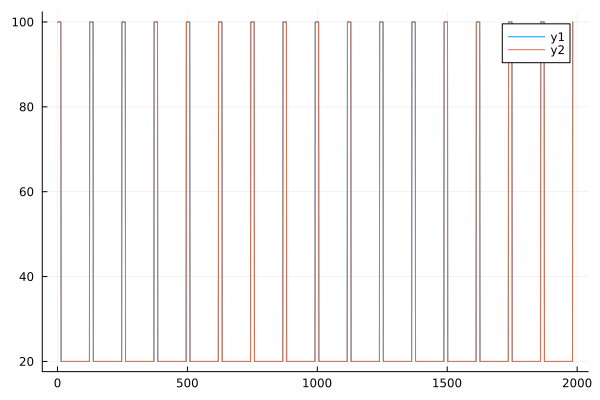

In [431]:
Plots.plot(hcat(sol.u...)[1, :])
Plots.plot!(hcat(sol.u...)[n+1, :])

# Plots.plot!(hcat(sol.u...)[2, :], label="albumen", color=:grey)

In [ ]:
Ai_yolk = 2.72
Ai_albumen = 

In [ ]:
# Define your parameters
R_i(t) =  # Define your A_i(t) function here
dt = 0.01  # Time step
t_end = 10.0  # End time
t = 0:dt:t_end  # Time array
X_i = zeros(length(t))  # Initialize X_i array
X_i[1] = 1.0  # Initial condition for X_i

# Trapezoidal integration
for n in 1:length(t)-1
    t_n = t[n]
    t_n1 = t[n+1]
    A_n = R_i(t_n)
    A_n1 = R_i(t_n1)
    X_n = X_i[n]
    f_n = A_n * (1 - X_n)
    X_tilde = X_n + dt * f_n  # Euler prediction
    f_tilde = A_n1 * (1 - X_tilde)
    X_i[n+1] = X_n + (dt / 2) * (f_n + f_tilde)  # Trapezoidal correction
end

# Now X_i contains the solution at each time step


LoadError: ParseError:
[90m# Error @ [0;0m]8;;file:///Users/torque/programs/egg_sims/In[539]#2:10\[90mIn[539]:2:10[0;0m]8;;\
# Define your parameters
A_i(t) = [48;2;120;70;70m...[0;0m # Define your A_i(t) function here
[90m#        └─┘ ── [0;0m[91minvalid identifier[0;0m

In [547]:
using LinearAlgebra
using DiffEqBase
using OrdinaryDiffEq: SplitODEProblem, solve, IMEXEuler
# using OrdinaryDiffEqBDF: IMEXEuler
import SciMLBase

In [548]:
using Plots

In [755]:
ρ_yolk = 1030.0   # kg/m^3
ρ_albumen = 1020.0  # kg/m^3
c_p_yolk = 3.7  # kJ/(kg·°C)
c_p_albumen = 3.8  # kJ/(kg·°C)
k_yolk = 0.5  # W/(m·°C)
k_albumen = 0.6  # W/(m·°C)

α_yolk = k_yolk / (ρ_yolk * c_p_yolk) # m^2/s
α_albumen = k_albumen / (ρ_albumen * c_p_albumen) # m^2/s

# renormalize for egg lengthscales
# 62mm	43mm
egg_diameter = 10 * 62e-3 # 43mm
α_yolk /= egg_diameter^2 # mm/s
α_albumen /= egg_diameter^2 # mm/s

α_yolk, α_albumen

(0.00034130894985789256, 0.0004027022934701017)

In [828]:
a, b, n = 0, 1, 50               # zmin, zmax, number of cells
n_yolk = 11
n̂_min, n̂_max = -1, 1            # Outward facing unit vectors
# α = α_albumen;                        # thermal diffusivity, larger means more stiff
β, γ = 0, π;                # source term coefficients
Δt = 1; #1000;                      # timestep size
@show N_t = Integer(ceil(32*60 / Δt));                       # number of timesteps to take
FT = Float64;                   # float type
Δz = FT(b - a) / FT(n)
Δz² = Δz^2;
∇²_op = [1 / Δz², -2 / Δz², 1 / Δz²]; # interior Laplacian operator
# ∇T_bottom = 100; #100;                 # Temperature gradient at the top
# T_bottom = 60;
# T_top = 60;                      # Temperature at the bottom

T_hot = 100;
T_cold = 20;
S(z) = β * sin(γ * z)               # source term, (sin for easy integration)
zf = range(a, b, length = n + 1);   # coordinates on cell faces

pulsing_period = 2*60;
# pulsing_asym = 3;

N_t = Integer(ceil((32 * 60) / Δt)) = 1920


┌ Warning: Skipped marker arg o.
└ @ Plots ~/.julia/packages/Plots/Ec1L1/src/args.jl:1149


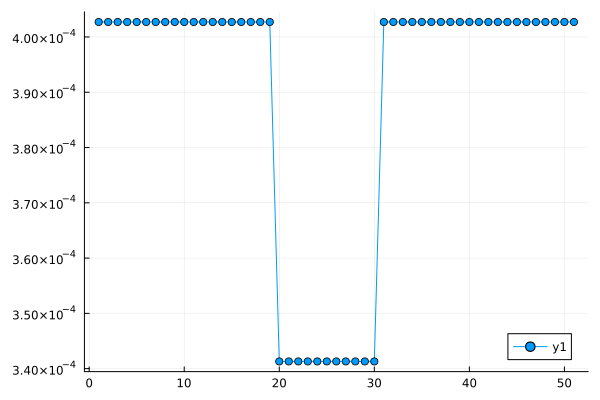

In [829]:
# # Make a vector α_vec of length n  that begins and ends with α_albumen and the middle n_yolk items are α_yolk
# α_vec = [α_albumen for i in 1:n]
# α_vec[1 + div(n - 1, 2) - div(n_yolk, 2):1 + div(n - 1, 2) + div(n_yolk, 2)] .= α_yolk

α_vec = [α_albumen for i in 1:n+1]
α_vec[1 + div(n - 1, 2) - div(n_yolk, 2):1 + div(n - 1, 2) + div(n_yolk, 2)] .= α_yolk
plot(α_vec, marker="o")

In [830]:
function T_analytic(z) # Analytic steady state solution
    c1 = T_bottom #∇T_bottom - β * cos(γ * a) / (γ * α)
    c2 = T_top - (β * sin(γ * b) / (γ^2 * α) + c1 * b)
    return β * sin(γ * z) / (γ^2 * α) + c1 * z + c2
end

T_analytic (generic function with 1 method)

In [831]:
# Initialize interior and boundary stencils:
∇² = Tridiagonal(ones(FT, n) .* ∇²_op[1],
    ones(FT, n + 1) .* ∇²_op[2],
    ones(FT, n) .* ∇²_op[3]);

# Modify boundary stencil to account for BCs

# ∇².d[1] = -2 / Δz²
# ∇².du[1] = +2 / Δz²

∇².du[1] = 0  # modified stencil
∇².d[1] = 0 # to ensure `∂_t T = 0` at `z=0`
∇².dl[1] = 0  # to ensure `∂_t T = 0` at `z=0`

# Modify boundary stencil to account for BCs
∇².du[n] = 0  # modified stencil
∇².d[n + 1] = 0 # to ensure `∂_t T = 0` at `z=zmax`
∇².dl[n] = 0  # to ensure `∂_t T = 0` at `z=zmax`
D = α_vec .* ∇²

51×51 Matrix{Float64}:
 0.0   0.0       0.0       0.0      …   0.0       0.0       0.0      0.0
 0.0  -2.01351   1.00676   0.0          0.0       0.0       0.0      0.0
 0.0   1.00676  -2.01351   1.00676      0.0       0.0       0.0      0.0
 0.0   0.0       1.00676  -2.01351      0.0       0.0       0.0      0.0
 0.0   0.0       0.0       1.00676      0.0       0.0       0.0      0.0
 0.0   0.0       0.0       0.0      …   0.0       0.0       0.0      0.0
 0.0   0.0       0.0       0.0          0.0       0.0       0.0      0.0
 0.0   0.0       0.0       0.0          0.0       0.0       0.0      0.0
 0.0   0.0       0.0       0.0          0.0       0.0       0.0      0.0
 0.0   0.0       0.0       0.0          0.0       0.0       0.0      0.0
 0.0   0.0       0.0       0.0      …   0.0       0.0       0.0      0.0
 0.0   0.0       0.0       0.0          0.0       0.0       0.0      0.0
 0.0   0.0       0.0       0.0          0.0       0.0       0.0      0.0
 ⋮                          

In [832]:
# AT_b = zeros(FT, n + 1);
# AT_b[2] = α_albumen * T_hot / Δz²; #α * 2 / Δz * ∇T_bottom * n̂_min;
# AT_b[end - 1] = α_albumen * T_hot / Δz²;

In [833]:
T = zeros(FT, n + 1);
T .= 32; 
T[1] = T_hot; # set top BC
T[n + 1] = T_hot; # set top BC

In [834]:
function temp_from_thermal_state(thermal_state)
    if thermal_state == 0
        return T_hot
    else
        return T_cold
    end
end

function condition(u, t, integrator)
    mod(t, pulsing_period) == 0
end

function affect!(integrator)
    thermal_state = mod(integrator.p[2] + 1, 3)
    integrator.p = (; n=integrator.p[1], thermal_state=thermal_state)

    T = temp_from_thermal_state(thermal_state)

    integrator.u[1] = T
    integrator.u[2] = T
    integrator.u[end-1] = T
    integrator.u[end] = T
end

cb = DiscreteCallback(condition, affect!)

DiscreteCallback{typeof(condition), typeof(affect!), typeof(SciMLBase.INITIALIZE_DEFAULT), typeof(SciMLBase.FINALIZE_DEFAULT), Nothing}(Main.condition, Main.affect!, SciMLBase.INITIALIZE_DEFAULT, SciMLBase.FINALIZE_DEFAULT, Bool[1, 1], nothing)

In [835]:
function rhs!(dT, T, params, t)
    n = params.n
    i = 1:n # interior domain
    # dT[i] .= S.(zf[i]) .+ AT_b[i]
    AT_b = α_albumen * temp_from_thermal_state(params.thermal_state) / Δz²; #zeros(FT, n + 1);
    # AT_b[2] = α_albumen * temp_from_thermal_state(params.thermal_state) / Δz²
    # AT_b[n-1] = α_albumen * temp_from_thermal_state(params.thermal_state) / Δz²
    # dT[i] .= AT_b[i]
    # dT = D * T
    dT .= 0
    dT[2] += AT_b 
    dT[end-1] += AT_b
    return dT
end;

In [836]:
# function simD!(dT, T, params, t)
#     dT = D * T
# end

function adaD(u, p, t)
    D
end

adaD (generic function with 1 method)

In [837]:
clamp(100, 0, 1)

1

In [841]:
params = (; n, thermal_state=0)

tspan = (FT(0), N_t * FT(Δt))

function update_func!(A, u, p, t)
    # A .= 0.
    # if t > 100
    A .= dynamic_alpha_vec(u) .* ∇²
    # end
    # A
    @show sum(A)
    A
end

prob = SplitODEProblem(SciMLBase.DiffEqArrayOperator(deepcopy(D); update_func=update_func!), #SciMLBase.DiffEqArrayOperator(adaD),  #SciMLBase.DiffEqArrayOperator(D), #simD!, #
    rhs!,
    T,
    tspan,
    params)
alg = IMEXEuler(autodiff=false)
println("Solving...")
sol = solve(prob,
    alg,
    dt = Δt,
    saveat = range(FT(0), N_t * FT(Δt), length = N_t),
    callback = cb,
    progress = true,
    progress_message = (dt, u, p, t) -> t);

sol.u

Solving...
sum(A) = -0.28075685522001903
sum(A) = -0.28075685522001903
sum(A) = -0.28075685522001903
sum(A) = -0.28075685539471484
sum(A) = -0.2807568552200186
sum(A) = -0.2807568552200186
sum(A) = -0.2807568552200186
sum(A) = -0.2807568552200186
sum(A) = -0.2807568552200186
sum(A) = -0.28075685522001903
sum(A) = -0.28075685522001903
sum(A) = -0.28075685522001903
sum(A) = -0.28075685522001903
sum(A) = -0.28075685522001903
sum(A) = -0.28075685522001903
sum(A) = -0.28075685522001814
sum(A) = -0.2807568552200186
sum(A) = -0.2807568552200186
sum(A) = -0.2807568552200186
sum(A) = -0.2807568552200186
sum(A) = -0.2807568552200186
sum(A) = -0.28075685522001903
sum(A) = -0.2807568552200186
sum(A) = -0.28075685522001903
sum(A) = -0.2807568552200186
sum(A) = -0.28075685522001903
sum(A) = -0.2807568552200186
sum(A) = -0.28075685522001903
sum(A) = -0.28075685522001903
sum(A) = -0.28075685522001903
sum(A) = -0.28075685522001903
sum(A) = -0.28075685522001903
sum(A) = -0.28075685522001903
sum(A) = -0.

Excessive output truncated after 524298 bytes.


sum(A) = -0.34952267552226157
sum(A) = -0.34952267552226113
sum(A) = -0.34952267552226157
sum(A) = -0.34952267552226024
sum(A) = -0.3495226755222607
sum(A) = -0.3495226755222607
sum(A) = -0.34952267552226157
sum(A) = -0.34952267552226024
sum(A) = -0.3495226755222607
sum(A) = -0.3495226755222607
sum(A) = -0.3495226755222607
sum(A) = -0.3495226755222607
sum(A) = -0.34952267552226157
sum(A) = -0.34952267552226024
sum(A) = -0.34952267552226113
sum(A) = -0.3495226755222607
sum(A) = -0.3495226755222607
sum(A) = -0.3495226755222607
sum(A) = -0.34952267552226024
sum(A) = -0.34952267552226024
sum(A) = -0.3495226755222607
sum(A) = -0.34952267552226024
sum(A) = -0.34952267552226024
sum(A) = -0.34952267552226024
sum(A) = -0.3495226755222607
sum(A) = -0.3495226755222607
sum(A) = -0.34952267552226024
sum(A) = -0.3495226755222607
sum(A) = -0.3495226755222607
sum(A) = -0.3495226755222607
sum(A) = -0.34952267552226024
sum(A) = -0.3495226755222607
sum(A) = -0.3495226755222607
sum(A) = -0.34952267552226

1951-element Vector{Vector{Float64}}:
 [100.0, 32.0, 32.0, 32.0, 32.0, 32.0, 32.0, 32.0, 32.0, 32.0  …  32.0, 32.0, 32.0, 32.0, 32.0, 32.0, 32.0, 32.0, 32.0, 100.0]
 [100.0, 104.03887280671273, 40.12847808449965, 32.903580509777576, 32.10027774540956, 32.01112659765749, 32.001234557560934, 32.000136980680594, 32.00001519872603, 32.00000168637844  …  32.00000168637844, 32.00001519872603, 32.000136980680594, 32.00123455756095, 32.0111265976576, 32.100277745410416, 32.903580509783524, 40.1284780845375, 104.03887280690435, 100.0]
 [100.0, 154.01641260963595, 52.56688622664287, 35.018633162765965, 32.41549308957104, 32.055014874637465, 32.00709275078494, 32.00089665604907, 32.00011165793544, 32.000013739274166  …  32.000013739274166, 32.00011165793544, 32.00089665604907, 32.007092750784985, 32.05501487463776, 32.41549308957276, 35.01863316277655, 52.56688622668918, 154.01641260976487, 100.0]
 [100.0, 186.79666648757737, 66.69380329649485, 38.31611641114262, 33.035565417766605, 32.1590686976

In [842]:
sol.u

1951-element Vector{Vector{Float64}}:
 [100.0, 32.0, 32.0, 32.0, 32.0, 32.0, 32.0, 32.0, 32.0, 32.0  …  32.0, 32.0, 32.0, 32.0, 32.0, 32.0, 32.0, 32.0, 32.0, 100.0]
 [100.0, 104.03887280671273, 40.12847808449965, 32.903580509777576, 32.10027774540956, 32.01112659765749, 32.001234557560934, 32.000136980680594, 32.00001519872603, 32.00000168637844  …  32.00000168637844, 32.00001519872603, 32.000136980680594, 32.00123455756095, 32.0111265976576, 32.100277745410416, 32.903580509783524, 40.1284780845375, 104.03887280690435, 100.0]
 [100.0, 154.01641260963595, 52.56688622664287, 35.018633162765965, 32.41549308957104, 32.055014874637465, 32.00709275078494, 32.00089665604907, 32.00011165793544, 32.000013739274166  …  32.000013739274166, 32.00011165793544, 32.00089665604907, 32.007092750784985, 32.05501487463776, 32.41549308957276, 35.01863316277655, 52.56688622668918, 154.01641260976487, 100.0]
 [100.0, 186.79666648757737, 66.69380329649485, 38.31611641114262, 33.035565417766605, 32.1590686976

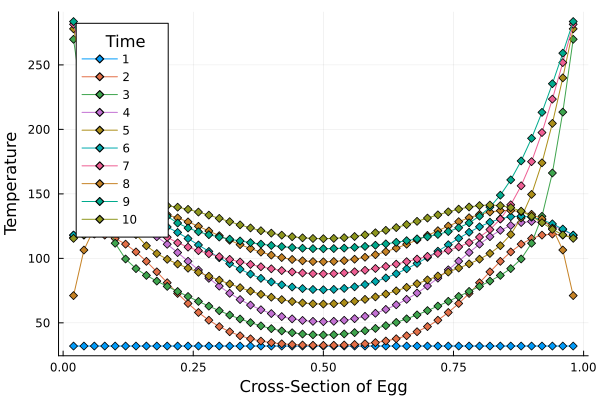

In [843]:
p1 = Plots.plot(ylabel="Temperature", xlabel="Cross-Section of Egg", legend_title="Time")
for (idx, tvec) in enumerate(sol.u[1:Integer(floor(N_t//10)):N_t])
    Plots.plot!(zf[2:end-1], tvec[2:end-1], label = idx, markershape = :diamond)
end
p1

In [ ]:
using Statistics
median

median (generic function with 7 methods)

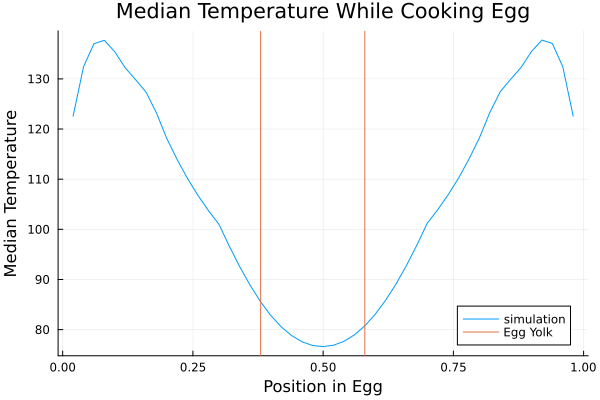

In [844]:
# Plots.plot!(zf[2:end-1], tvec[2:end-1], label = idx, markershape = :diamond)
plot(zf[2:end-1], median(hcat(sol.u...)[2:end-1, :]; dims=2), label="simulation", ylabel="Median Temperature", title="Median Temperature While Cooking Egg", xlabel="Position in Egg")

vline!(zf[[1 + div(n - 1, 2) - div(n_yolk, 2), 1 + div(n - 1, 2) + div(n_yolk, 2)]], label="Egg Yolk")

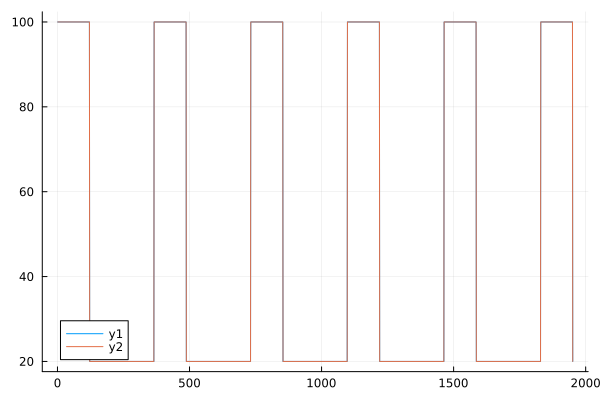

In [845]:
Plots.plot(hcat(sol.u...)[1, :])
Plots.plot!(hcat(sol.u...)[n+1, :])

# Plots.plot!(hcat(sol.u...)[2, :], label="albumen", color=:grey)

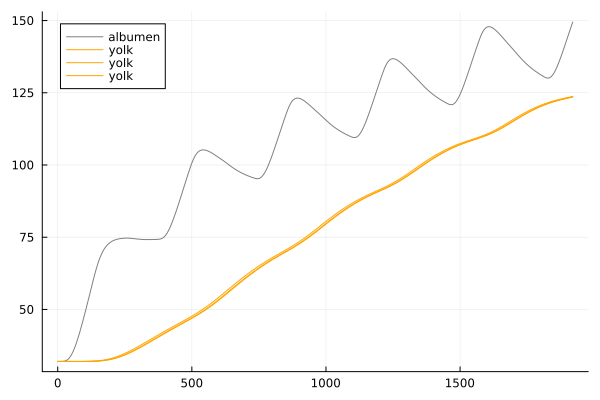

In [846]:
Plots.plot()

# 
# Plots.plot!(hcat(sol.u...)[2, :], label="albumen", color=:grey)
# Plots.plot!(sol.t, hcat(sol.u...)[3, :], label="albumen", color=:grey)
# Plots.plot!(sol.t, hcat(sol.u...)[4, :], label="albumen", color=:grey)
Plots.plot!(sol.t, hcat(sol.u...)[Integer(floor(n/4)), :], label="albumen", color=:grey)
# Plots.plot!(hcat(sol.u...)[5, :], label="albumen", color=:grey)
# Plots.plot!(hcat(sol.u...)[Integer(floor(n/2)) - 2, :], label="yolk", color=:orange)
Plots.plot!(sol.t, hcat(sol.u...)[Integer(floor(n/2)) - 1, :], label="yolk", color=:orange)
Plots.plot!(sol.t, hcat(sol.u...)[Integer(floor(n/2)) + 0, :], label="yolk", color=:orange)
Plots.plot!(sol.t, hcat(sol.u...)[Integer(floor(n/2)) + 1, :], label="yolk", color=:orange)
# Plots.plot!(hcat(sol.u...)[Integer(floor(n/2)) + 2, :], label="yolk", color=:orange)
# Plots.plot!(hcat(sol.u...)[n-3, :], label="albumen", color=:black)
# Plots.plot!(sol.t, hcat(sol.u...)[n-2, :], label="albumen", color=:black)
# Plots.plot!(sol.t, hcat(sol.u...)[n-1, :], label="albumen", color=:black)
# Plots.plot!(hcat(sol.u...)[n, :], label="albumen", color=:black)


In [ ]:
pulsed = hcat(sol.u...)[Integer(floor(n/2)) + 0, :]
pulsed_time = sol.t

1951-element Vector{Float64}:
    0.0
    1.0005211047420532
    2.0010422094841065
    3.0015633142261593
    4.002084418968213
    5.002605523710265
    6.003126628452319
    7.003647733194372
    8.004168837936426
    9.004689942678478
   10.00521104742053
   11.005732152162585
   12.006253256904637
    ⋮
 1909.9947889525795
 1910.9953100573216
 1911.9958311620635
 1912.9963522668056
 1913.9968733715477
 1914.9973944762896
 1915.9979155810317
 1916.9984366857739
 1917.998957790516
 1918.9994788952579
 1920.0
 1920.0

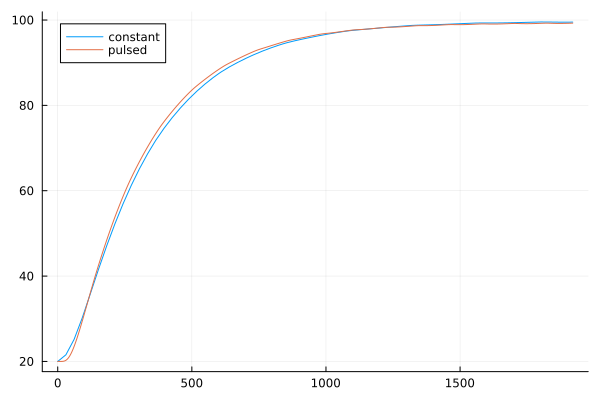

In [ ]:
Plots.plot(constant_time, constant, label="constant")
Plots.plot!(pulsed_time, pulsed, label="pulsed")

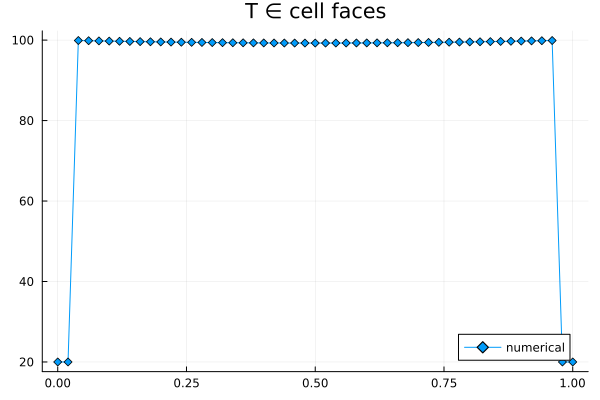

In [ ]:
T_end = sol.u[end]

# p1 = Plots.plot(zf, T_analytic.(zf), label = "analytic", markershape = :circle,
#     markersize = 6)
p1 = Plots.plot()
p1 = Plots.plot!(p1, zf, T_end, label = "numerical", markershape = :diamond)
p1 = Plots.plot!(p1, title = "T ∈ cell faces")

# p2 = Plots.plot(zf, abs.(T_end .- T_analytic.(zf)), label = "error", markershape = :circle,
#     markersize = 6)
# p2 = Plots.plot!(p2, title = "T ∈ cell faces")

# Plots.plot(p1, p2)

In [ ]:
# using PyPlot
# T_end = sol.u[end]

# fig, ax = plt.subplots(1, 2, figsize=(8, 3.5))

# ax[1].plot(zf, T_analytic.(zf), label = "analytic", markershape = :circle,
#     markersize = 6)
# ax[1].plot(p1, zf, T_end, label = "numerical", markershape = :diamond)
# ax[1].plot(p1, title = "T ∈ cell faces")

# ax[2].plot(zf, abs.(T_end .- T_analytic.(zf)), label = "error", markershape = :circle,
#     markersize = 6)
# ax[2].plot(p2, title = "T ∈ cell faces")

# plt.show()
# # plt.plot(p1, p2)